In [1]:
import os
import sys
#sys.path.append('/home/cjw/Code/DeepLearning')

import tensorflow as tf
import numpy as np
import pandas as pd

from autoencoder import autoencoder_train
from autoencoder import network
from autoencoder import utils

/home/cjw/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
datadir = "/v/Data/cyto/mmCompensatedTifs/"
#datadir = "/media/cjw/Data/cyto/mmCompensatedTifs"

mmfiles = utils.list_mmfiles(datadir)
print(mmfiles)

mmdict = dict()

n_all_images = 0
for mmfilename in mmfiles:
#mmfilename = datadir + "Fish6_15_cjw_mean_zero.mm"
#mmfilename = datadir + "mmplate15-1.mm"
    mmheader = np.memmap(mmfilename, dtype="int32", mode='r',
                    shape=(4,))

    header_shape = mmheader.shape
    print(header_shape, mmheader)
    xshape = [mmheader[0], mmheader[1], mmheader[2], mmheader[3]]
    xshape = tuple(xshape)
    del mmheader
    n_all_images += xshape[0]
    
    m3 = np.memmap(mmfilename, dtype='float32', offset=128,
              mode='r', shape=xshape)
    key = mmfilename.split("/")[-1]
    mmdict[key] = m3

print(n_all_images)
mmdict.keys()

['/v/Data/cyto/mmCompensatedTifs/Fish4_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish3_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish4_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish1_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish2_ICE.mm', '/v/Data/cyto/mmCompensatedTifs/Fish2_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish5_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish1_Ice.mm', '/v/Data/cyto/mmCompensatedTifs/Fish6_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish3_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish4_ICE.mm', '/v/Data/cyto/mmCompensatedTifs/Fish6_ICE.mm', '/v/Data/cyto/mmCompensatedTifs/Fish3_ICE.mm', '/v/Data/cyto/mmCompensatedTifs/Fish6_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish2_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish5_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish1_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish5_ICE.mm']
(4,) [10000    64    64     5]
(4,) [10000    64    64     5]
(4,) [10000    64    64     5]
(4,) [10000    64    64 

dict_keys(['Fish4_Untreated.mm', 'Fish3_CCB.mm', 'Fish4_CCB.mm', 'Fish1_Untreated.mm', 'Fish2_ICE.mm', 'Fish2_CCB.mm', 'Fish5_CCB.mm', 'Fish1_Ice.mm', 'Fish6_CCB.mm', 'Fish3_Untreated.mm', 'Fish4_ICE.mm', 'Fish6_ICE.mm', 'Fish3_ICE.mm', 'Fish6_Untreated.mm', 'Fish2_Untreated.mm', 'Fish5_Untreated.mm', 'Fish1_CCB.mm', 'Fish5_ICE.mm'])

In [3]:
n = xshape[0]
all_ids =  range(n_all_images)
idx = 0
dataframes = list()
for key in mmdict.keys():
    mm = mmdict[key]
    n = mm.shape[0]
    print(n)
    file = n*[key[0:-3]]
    fid = range(n)
    mmfile = n*[key]
    plate = n*[0]
    row = n*[0]
    column = n*[0]
    field = n*[0]
    yc = n*[32]
    xc = n*[32]
    well = n*[0]
    ids = all_ids[idx:idx + n]
    idx += n
    df = pd.DataFrame({'id':ids, 'fid':fid, 'file':file, 'mmfile':mmfile, 'plate':plate,
                     'row':row, 'column':column, 'field':field,
                      'yc':yc, 'xc':xc, 'well':well})

    dataframes.append(df)
    
p_df = pd.concat(dataframes, ignore_index=True)

10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000


Encoder True
Tensor("Placeholder:0", shape=(?, 32, 32, 4), dtype=float32) (?, 32, 32, 4)
isize:  4 32
dh0 (?, 32, 32, 4)
180000 1406 128
Epoch:  0 Iteration:  0 Loss:  620.3248 616.90234 0.0


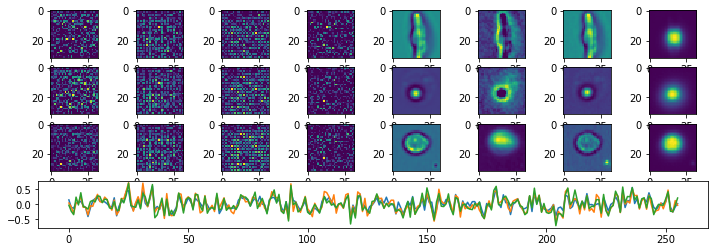

Epoch:  0 Iteration:  500 Loss:  13.923055 13.287001 0.0


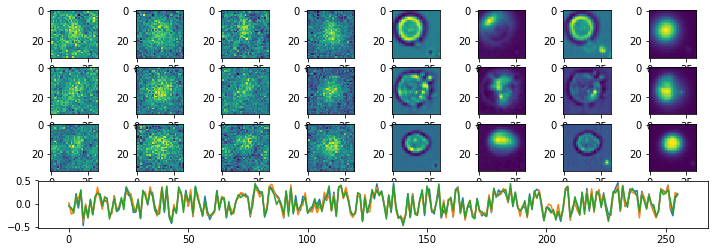

Epoch:  0 Iteration:  1000 Loss:  10.513197 9.878941 0.0


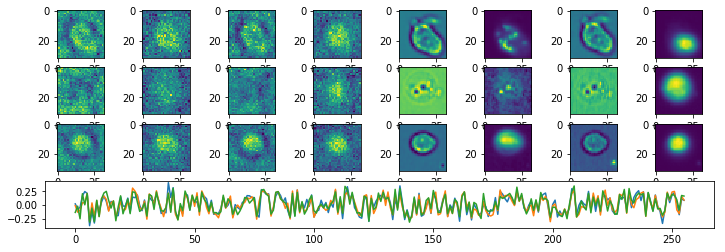

Epoch:  1 Iteration:  0 Loss:  8.615107 7.9821415 0.0


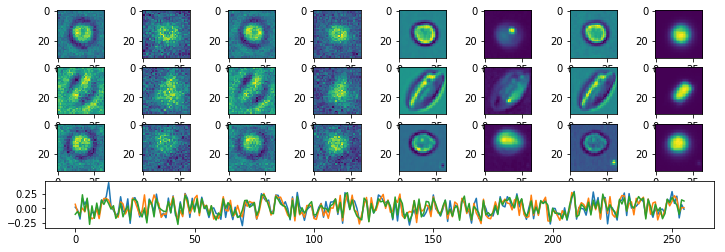

Epoch:  1 Iteration:  500 Loss:  7.5564013 6.9237204 0.0


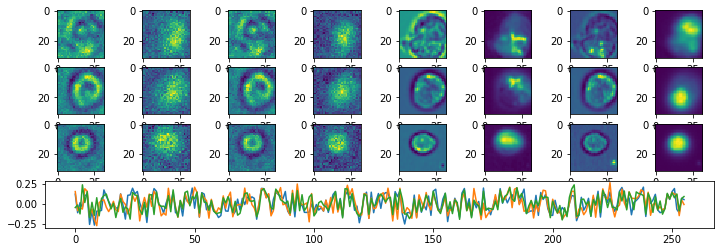

Epoch:  1 Iteration:  1000 Loss:  6.2032332 5.5712585 0.0


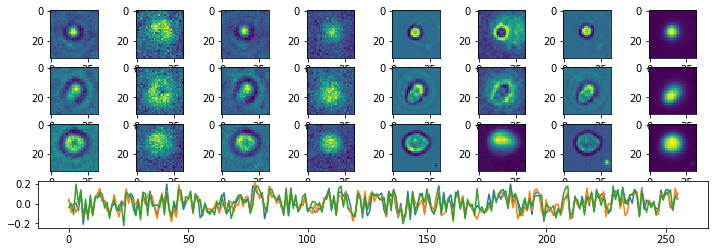

Epoch:  2 Iteration:  0 Loss:  5.5553546 4.9239902 0.0


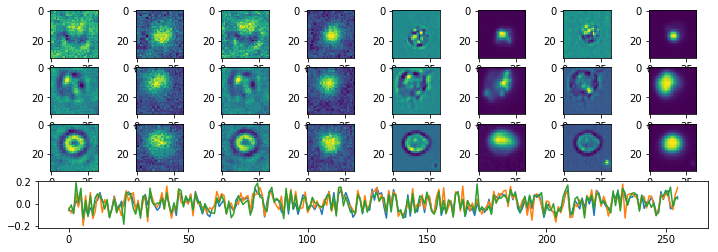

Epoch:  2 Iteration:  500 Loss:  5.156618 4.5251856 0.0


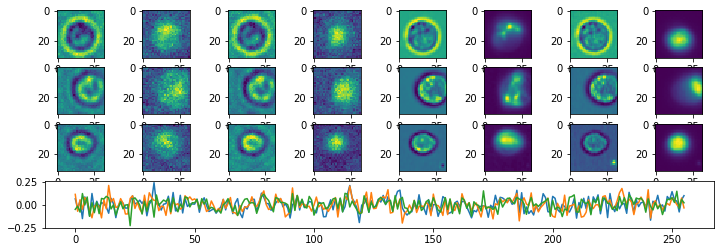

Epoch:  2 Iteration:  1000 Loss:  4.724714 4.093518 0.0


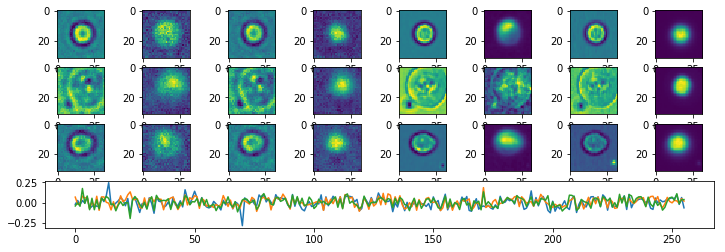

Epoch:  3 Iteration:  0 Loss:  4.28568 3.6549788 0.0


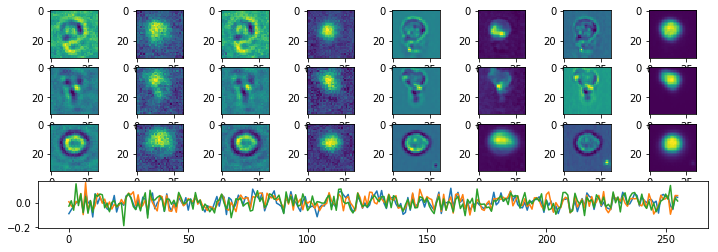

Epoch:  3 Iteration:  500 Loss:  4.168906 3.538005 0.0


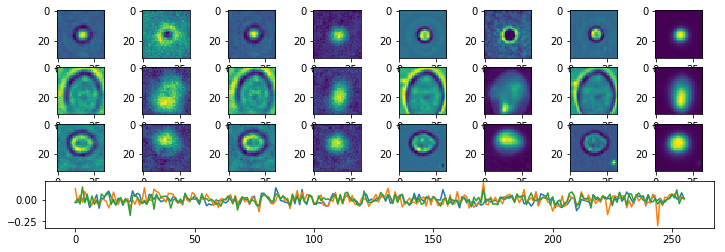

Epoch:  3 Iteration:  1000 Loss:  3.7504444 3.1197696 0.0


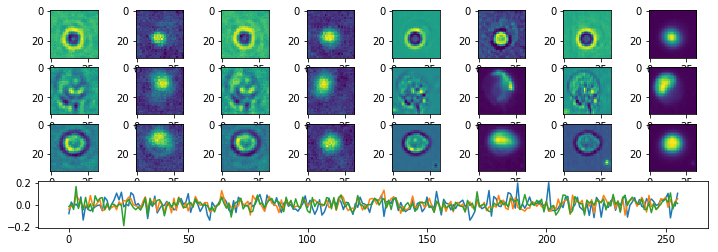

Epoch:  4 Iteration:  0 Loss:  3.4592447 2.828992 0.0


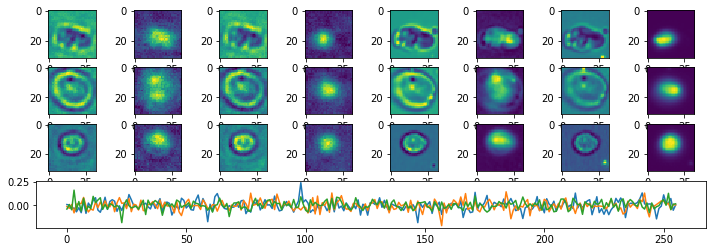

Epoch:  4 Iteration:  500 Loss:  3.4086974 2.7781978 0.0


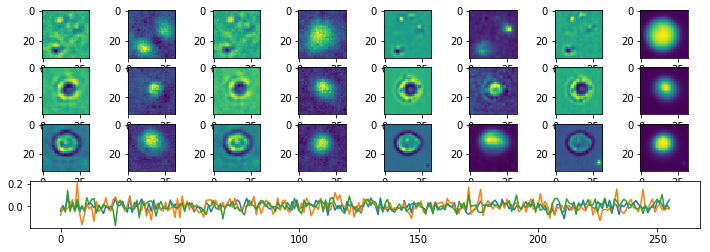

Epoch:  4 Iteration:  1000 Loss:  3.1739268 2.5435574 0.0


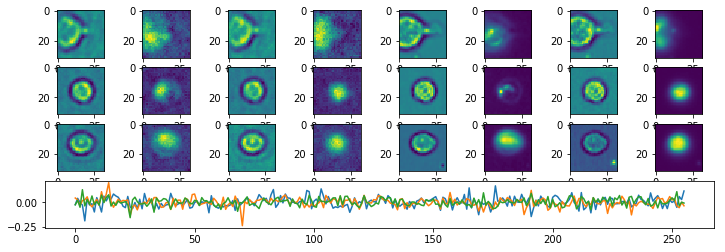

Epoch:  5 Iteration:  0 Loss:  2.9849482 2.3549476 0.0


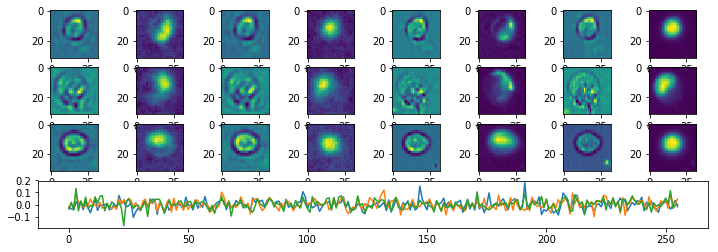

Epoch:  5 Iteration:  500 Loss:  2.9205174 2.2902741 0.0


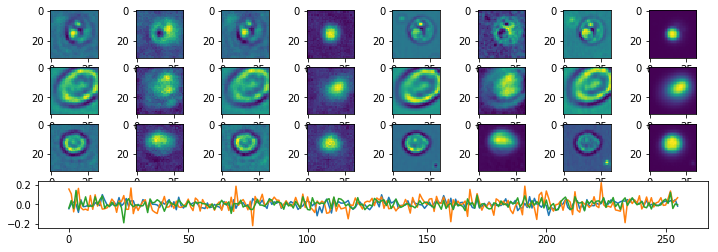

Epoch:  5 Iteration:  1000 Loss:  2.7775953 2.147432 0.0


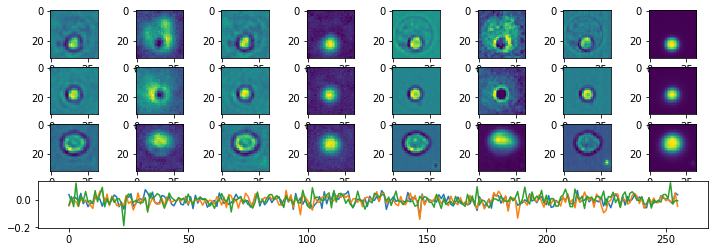

Epoch:  6 Iteration:  0 Loss:  2.6438873 2.0140657 0.0


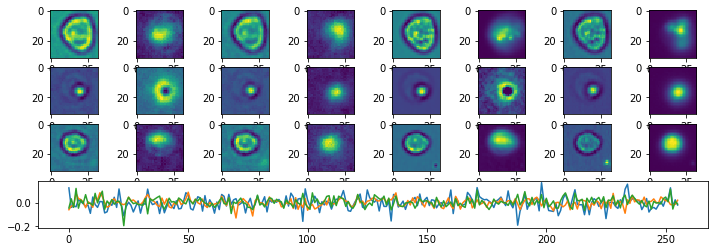

Epoch:  6 Iteration:  500 Loss:  2.6642885 2.0341802 0.0


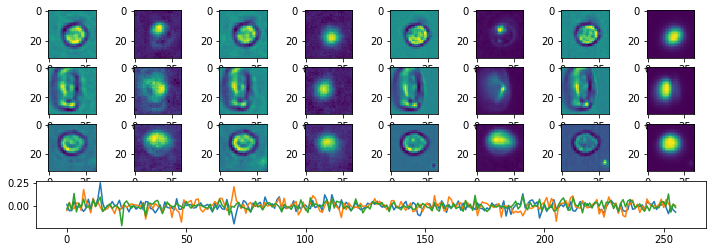

Epoch:  6 Iteration:  1000 Loss:  2.5025415 1.8725245 0.0


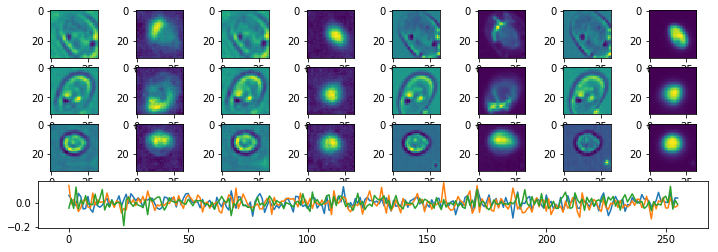

Epoch:  7 Iteration:  0 Loss:  2.3780994 1.7484162 0.0


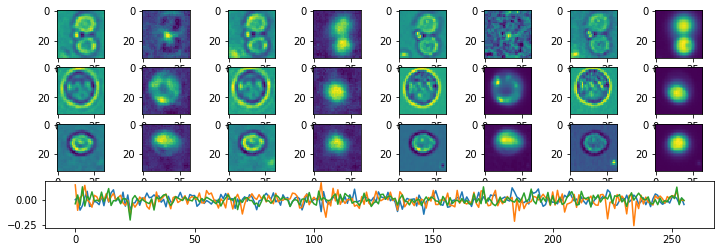

Epoch:  7 Iteration:  500 Loss:  2.3799808 1.7500199 0.0


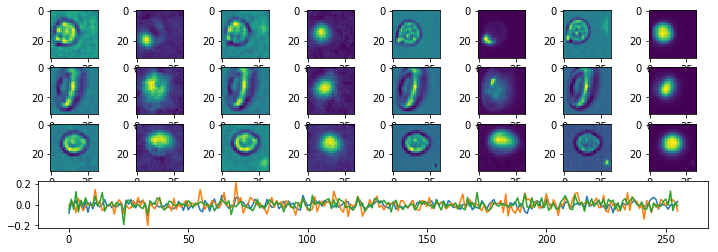

Epoch:  7 Iteration:  1000 Loss:  2.298252 1.6683413 0.0


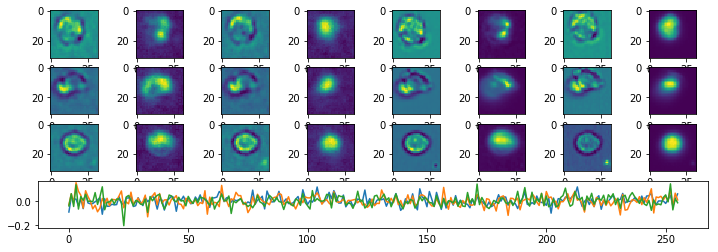

Epoch:  8 Iteration:  0 Loss:  2.1782677 1.5486882 0.0


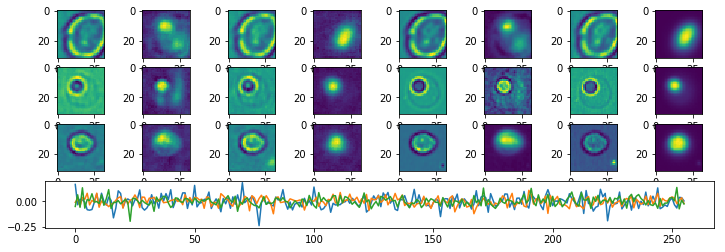

Epoch:  8 Iteration:  500 Loss:  2.2130563 1.5831813 0.0


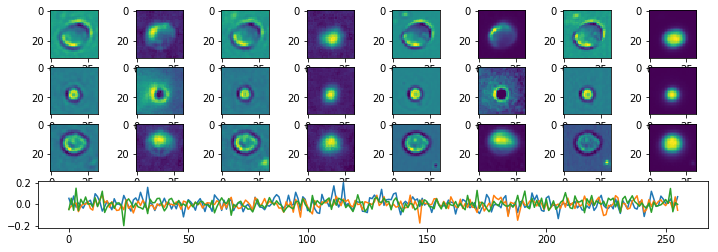

Epoch:  8 Iteration:  1000 Loss:  2.1240442 1.4942243 0.0


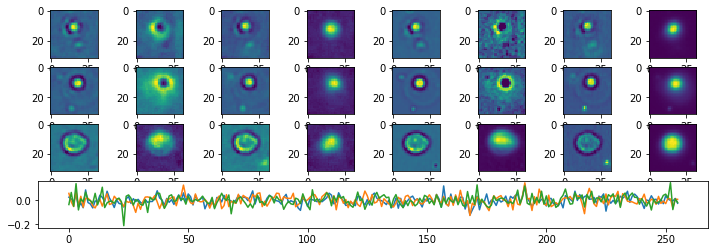

Epoch:  9 Iteration:  0 Loss:  2.0191817 1.3896852 0.0


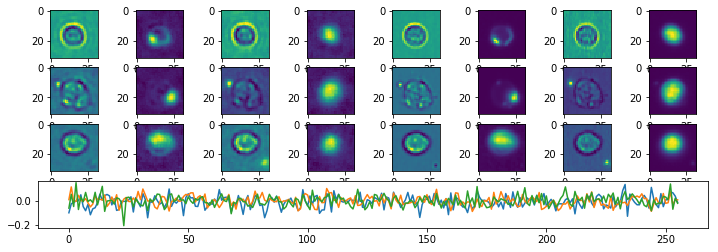

Epoch:  9 Iteration:  500 Loss:  2.0976963 1.467879 0.0


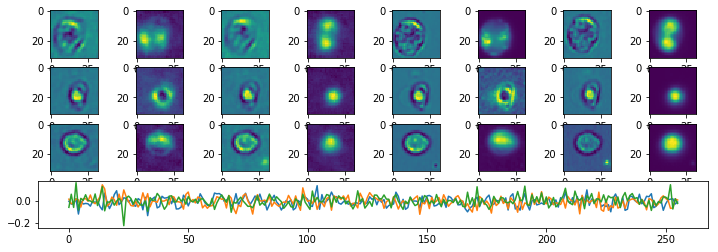

Epoch:  9 Iteration:  1000 Loss:  1.9629092 1.3331721 0.0


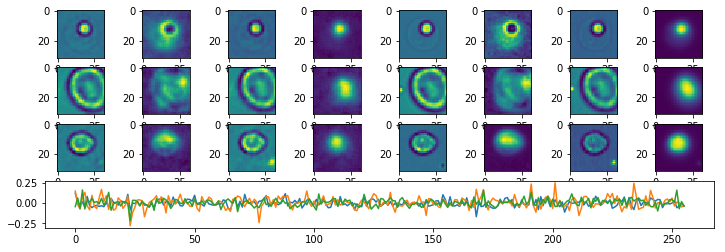

Epoch:  10 Iteration:  0 Loss:  1.8940257 1.2645936 0.0


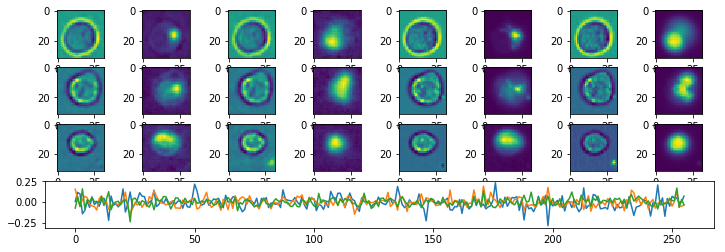

Epoch:  10 Iteration:  500 Loss:  1.9202849 1.2905616 0.0


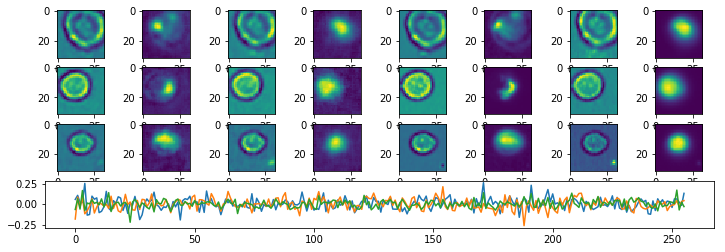

Epoch:  10 Iteration:  1000 Loss:  1.8467919 1.2171152 0.0


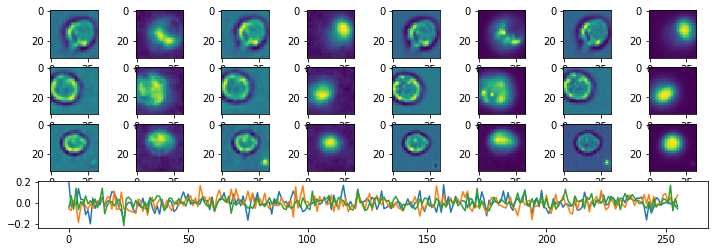

Epoch:  11 Iteration:  0 Loss:  1.8033797 1.1739942 0.0


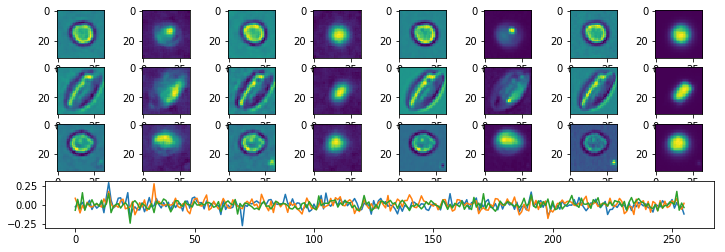

Epoch:  11 Iteration:  500 Loss:  1.8331678 1.2034894 0.0


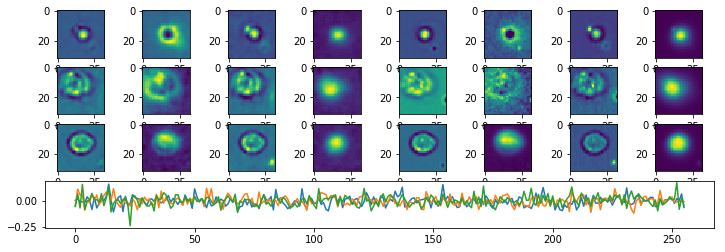

Epoch:  11 Iteration:  1000 Loss:  2.0886679 1.4588637 0.0


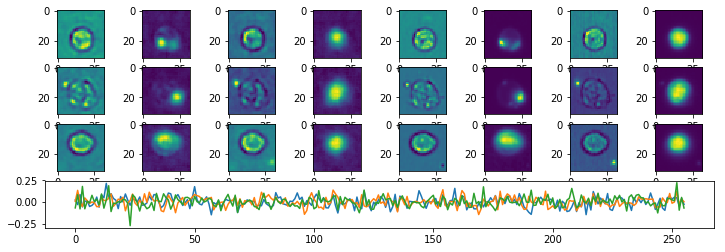

Epoch:  12 Iteration:  0 Loss:  1.9204524 1.2910054 0.0


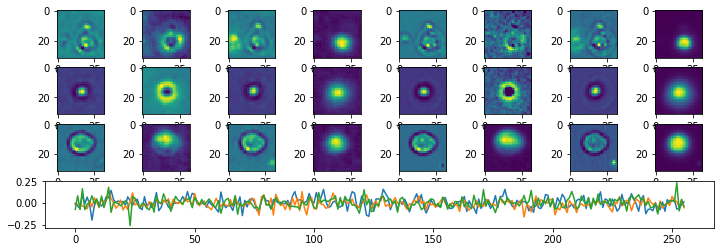

Epoch:  12 Iteration:  500 Loss:  1.9309915 1.3012624 0.0


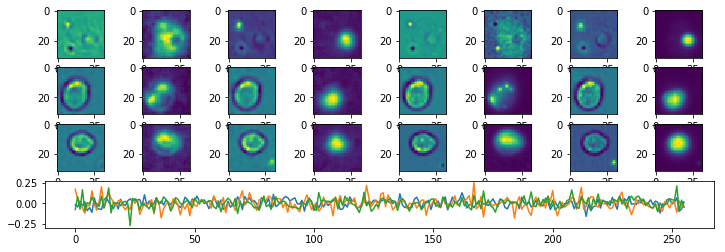

Epoch:  12 Iteration:  1000 Loss:  1.8645016 1.2348156 0.0


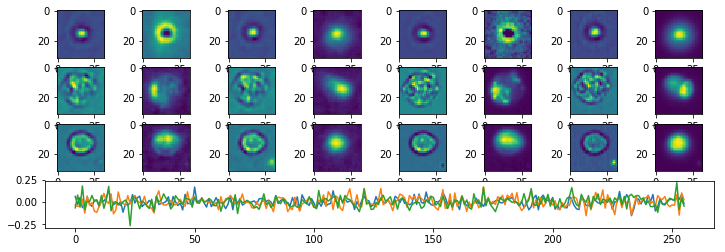

Epoch:  13 Iteration:  0 Loss:  1.8083117 1.178924 0.0


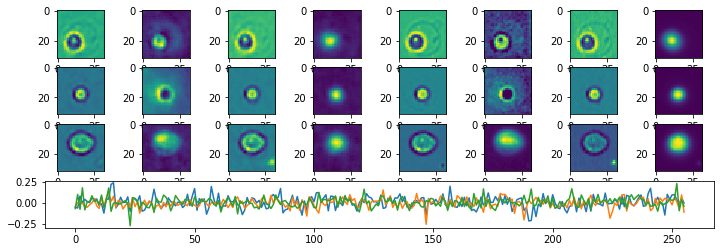

Epoch:  13 Iteration:  500 Loss:  1.8581474 1.2284567 0.0


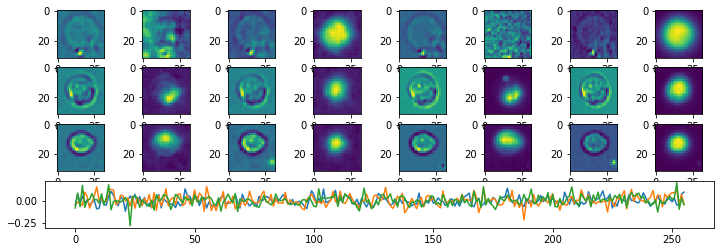

Epoch:  13 Iteration:  1000 Loss:  1.8029855 1.1733317 0.0


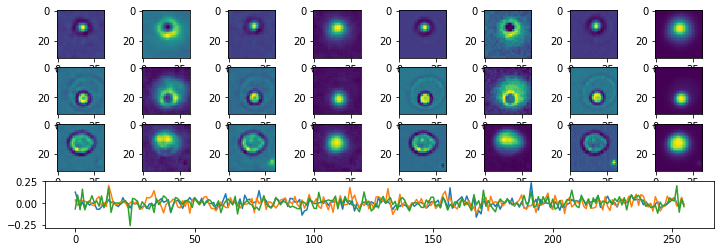

Epoch:  14 Iteration:  0 Loss:  1.7555647 1.126205 0.0


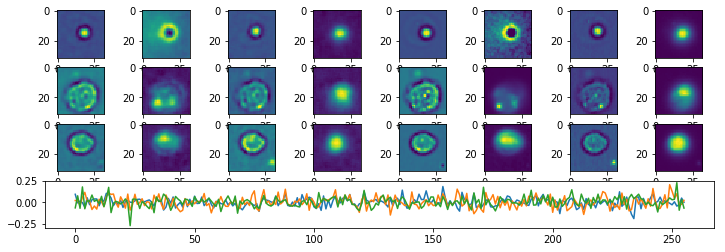

Epoch:  14 Iteration:  500 Loss:  1.8142688 1.1846012 0.0


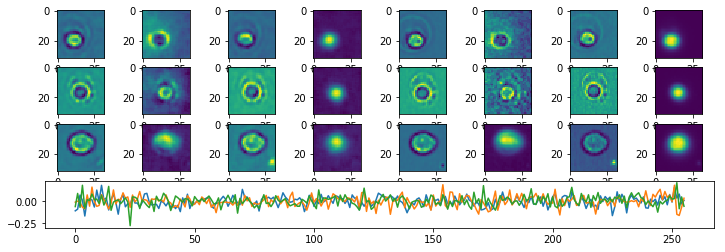

Epoch:  14 Iteration:  1000 Loss:  1.7656449 1.1360104 0.0


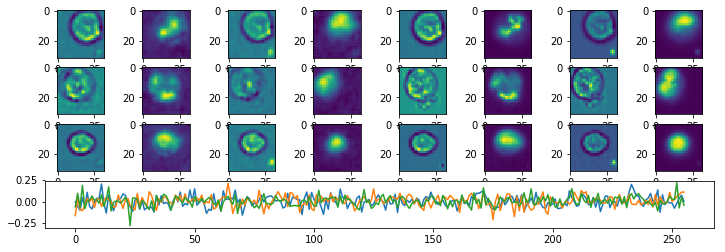

Epoch:  15 Iteration:  0 Loss:  1.7227561 1.0934132 0.0


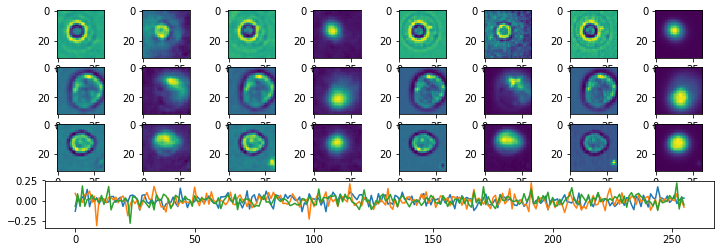

Epoch:  15 Iteration:  500 Loss:  1.7861831 1.1565293 0.0


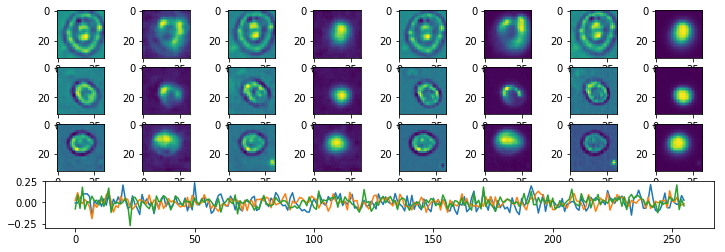

Epoch:  15 Iteration:  1000 Loss:  1.7259952 1.0963813 0.0


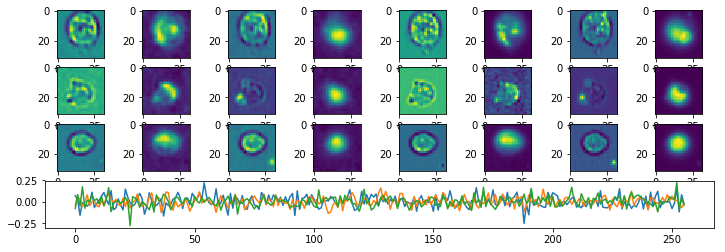

Epoch:  16 Iteration:  0 Loss:  1.6946418 1.0653135 0.0


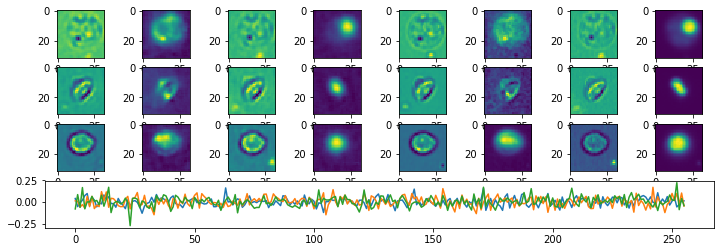

Epoch:  16 Iteration:  500 Loss:  1.7384949 1.1088665 0.0


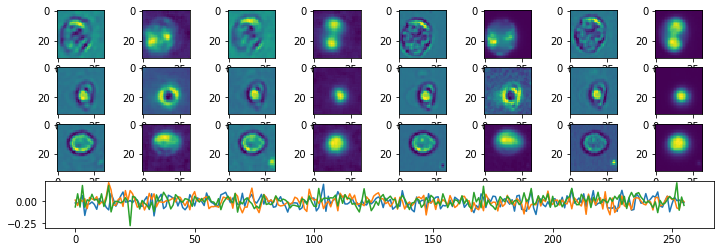

Epoch:  16 Iteration:  1000 Loss:  1.6870077 1.057415 0.0


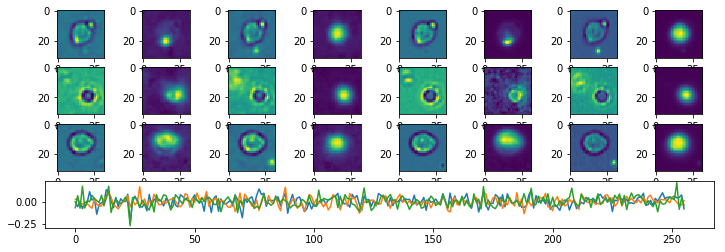

Epoch:  17 Iteration:  0 Loss:  1.6776721 1.048353 0.0


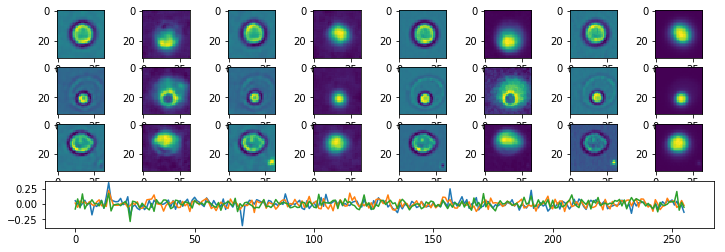

Epoch:  17 Iteration:  500 Loss:  1.6919885 1.0623841 0.0


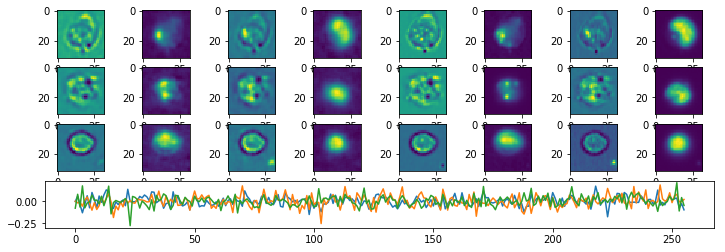

Epoch:  17 Iteration:  1000 Loss:  1.6430925 1.0135224 0.0


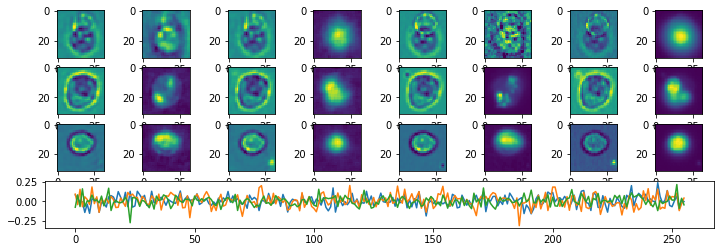

Epoch:  18 Iteration:  0 Loss:  1.6178629 0.9885743 0.0


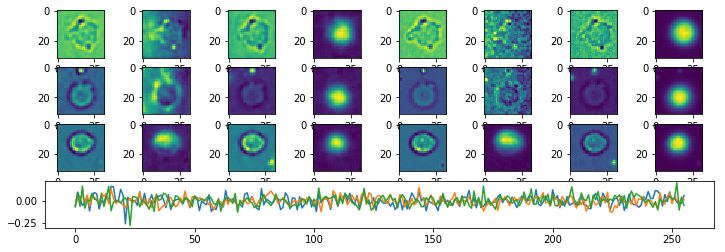

Epoch:  18 Iteration:  500 Loss:  1.6636125 1.0340228 0.0


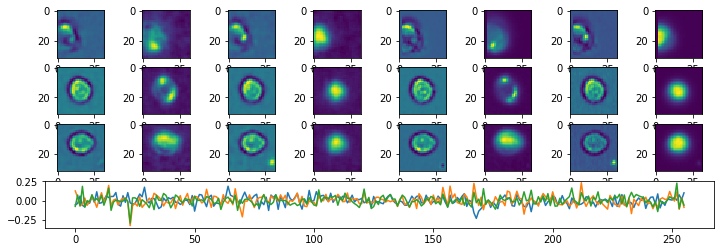

Epoch:  18 Iteration:  1000 Loss:  1.8993628 1.2696574 0.0


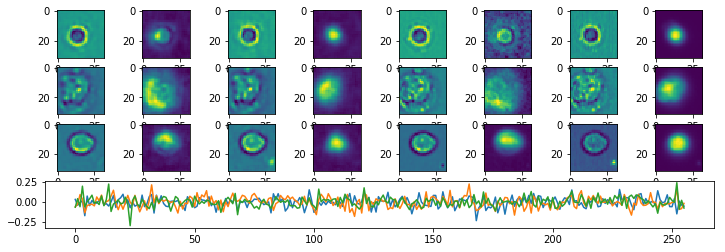

Epoch:  19 Iteration:  0 Loss:  1.7544291 1.1250687 0.0


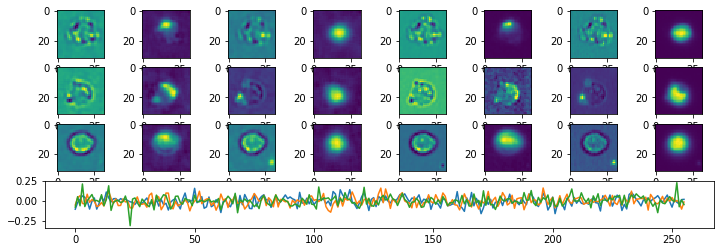

Epoch:  19 Iteration:  500 Loss:  1.7671499 1.1375058 0.0


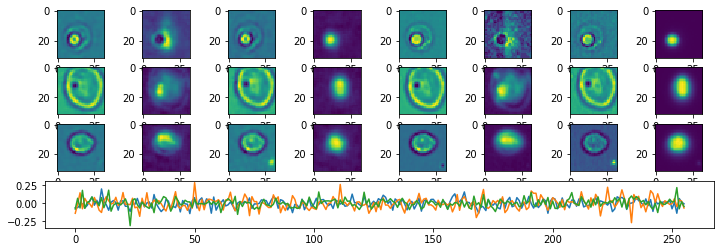

Epoch:  19 Iteration:  1000 Loss:  1.701095 1.0714937 0.0


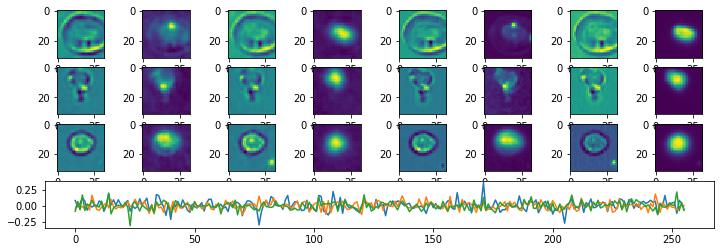

Epoch:  20 Iteration:  0 Loss:  1.6547942 1.025486 0.0


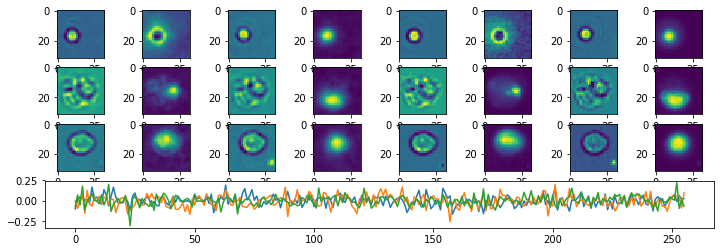

Epoch:  20 Iteration:  500 Loss:  1.6974688 1.0678613 0.0


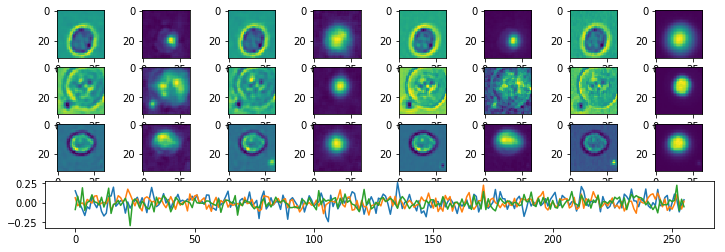

Epoch:  20 Iteration:  1000 Loss:  1.6492745 1.0197005 0.0


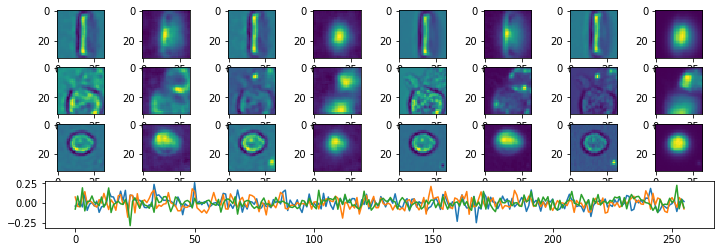

Epoch:  21 Iteration:  0 Loss:  1.6105003 0.9812155 0.0


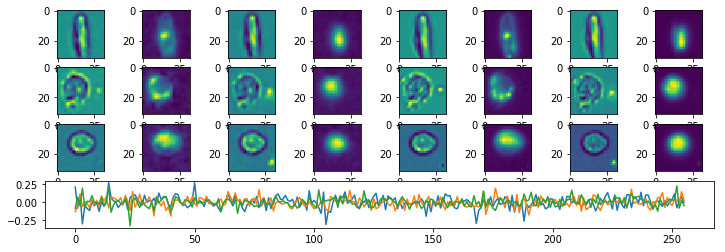

Epoch:  21 Iteration:  500 Loss:  1.6589462 1.0293591 0.0


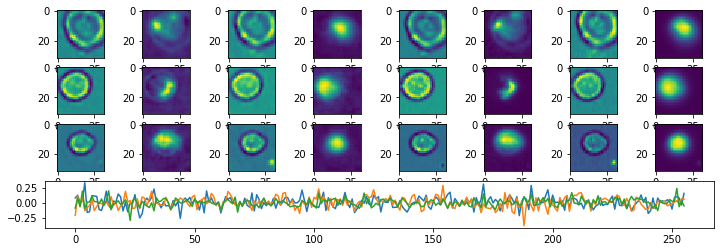

Epoch:  21 Iteration:  1000 Loss:  1.6104281 0.9808748 0.0


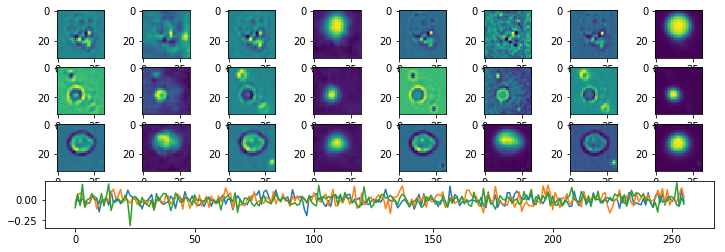

Epoch:  22 Iteration:  0 Loss:  1.5730639 0.943799 0.0


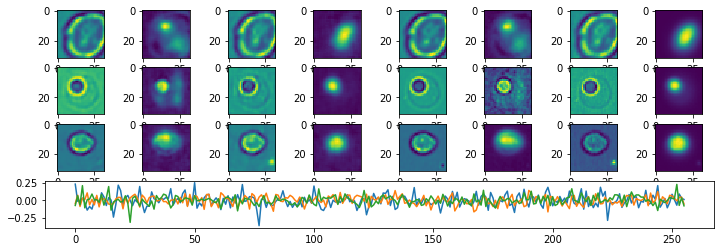

Epoch:  22 Iteration:  500 Loss:  1.6315936 1.0020208 0.0


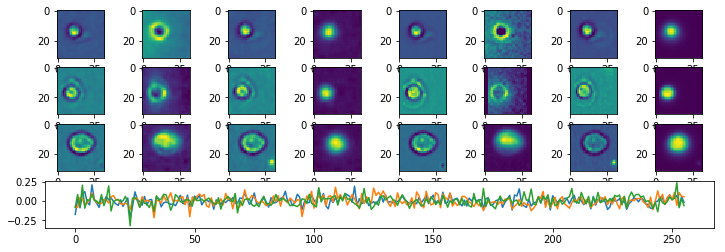

Epoch:  22 Iteration:  1000 Loss:  1.5809568 0.95141876 0.0


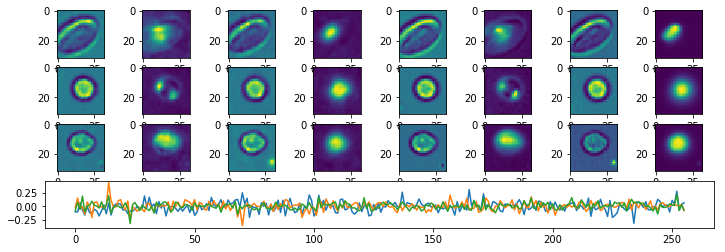

Epoch:  23 Iteration:  0 Loss:  1.5554464 0.9261904 0.0


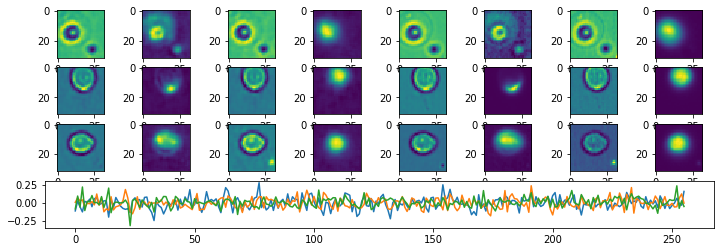

Epoch:  23 Iteration:  500 Loss:  1.6125154 0.9829526 0.0


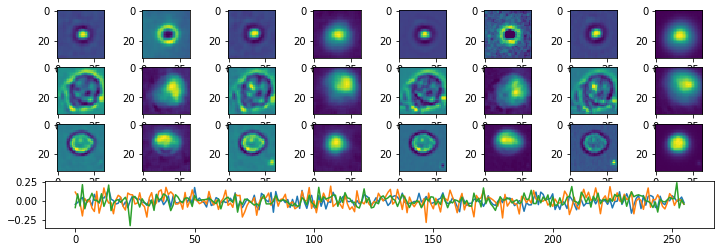

Epoch:  23 Iteration:  1000 Loss:  1.5674162 0.93788534 0.0


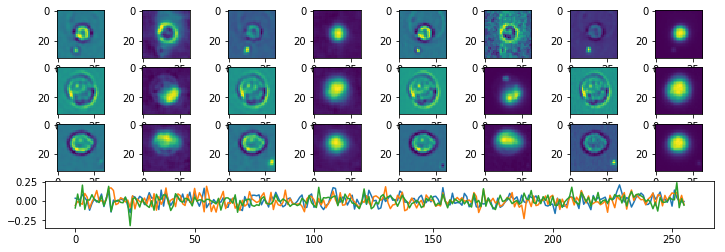

Epoch:  24 Iteration:  0 Loss:  1.5377604 0.90851367 0.0


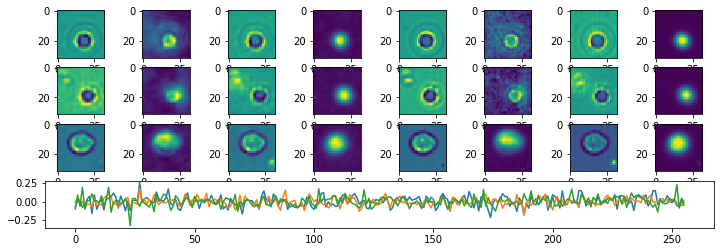

Epoch:  24 Iteration:  500 Loss:  1.5873125 0.95776236 0.0


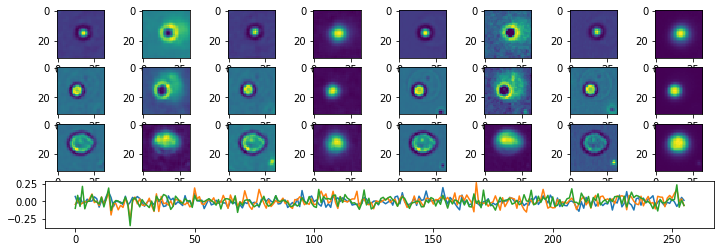

Epoch:  24 Iteration:  1000 Loss:  1.543719 0.9142002 0.0


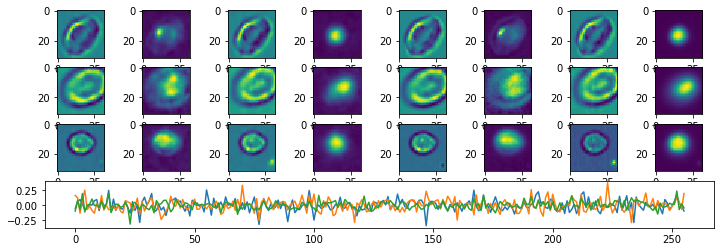

Epoch:  25 Iteration:  0 Loss:  1.5186661 0.88942957 0.0


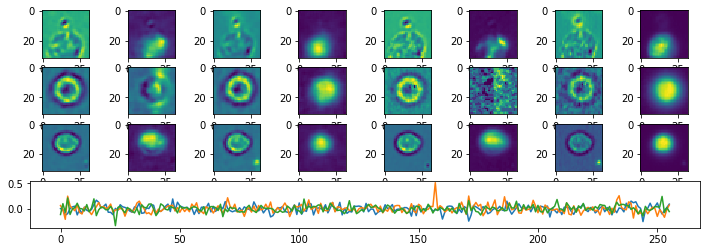

Epoch:  25 Iteration:  500 Loss:  1.5713687 0.9418267 0.0


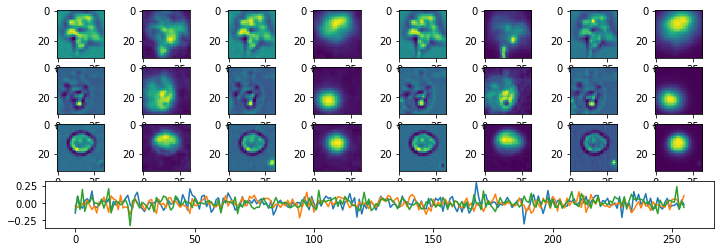

Epoch:  25 Iteration:  1000 Loss:  1.5246663 0.89515823 0.0


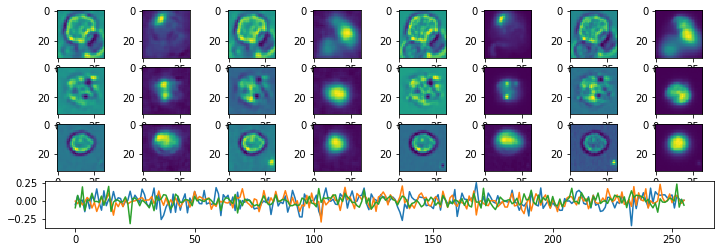

Epoch:  26 Iteration:  0 Loss:  1.4996611 0.87043417 0.0


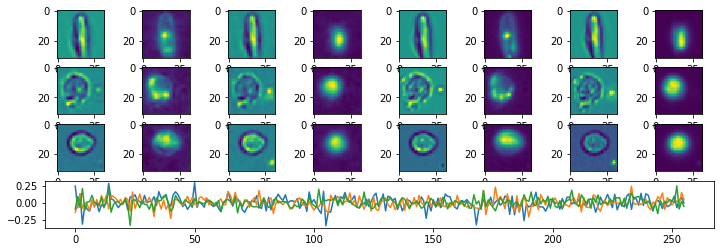

Epoch:  26 Iteration:  500 Loss:  1.5340065 0.9044845 0.0


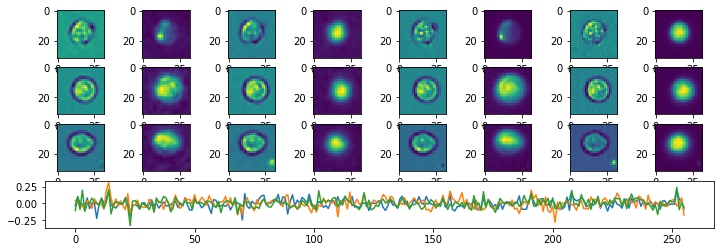

Epoch:  26 Iteration:  1000 Loss:  1.5124103 0.8829075 0.0


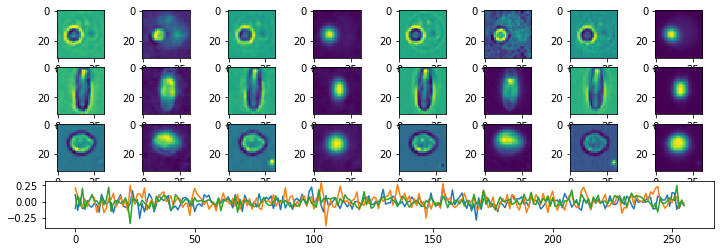

Epoch:  27 Iteration:  0 Loss:  1.4585505 0.82934517 0.0


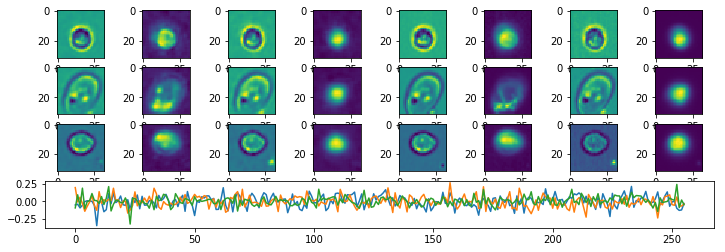

Epoch:  27 Iteration:  500 Loss:  1.7951982 1.1655372 0.0


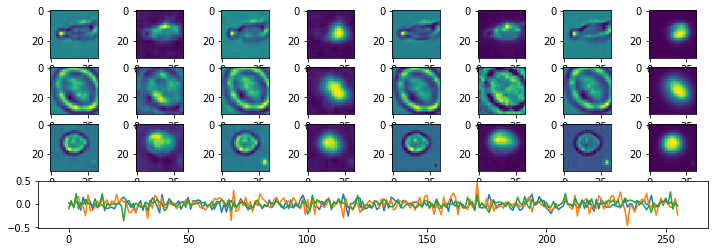

Epoch:  27 Iteration:  1000 Loss:  1.655217 1.0256383 0.0


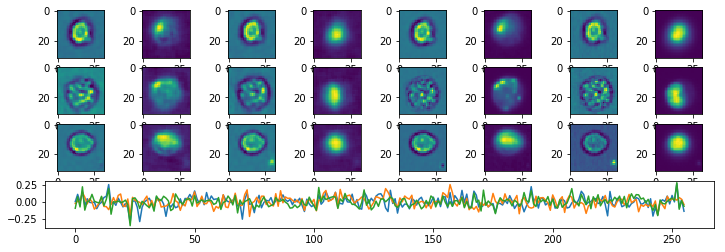

Epoch:  28 Iteration:  0 Loss:  1.5579753 0.9287167 0.0


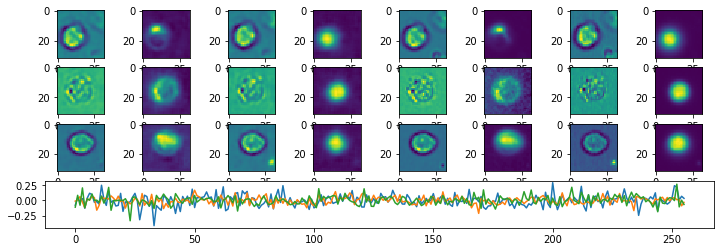

Epoch:  28 Iteration:  500 Loss:  1.6017778 0.9722205 0.0


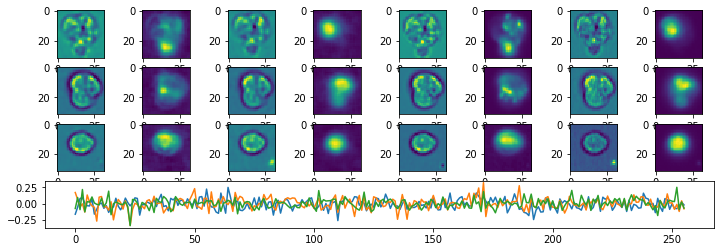

Epoch:  28 Iteration:  1000 Loss:  1.5572622 0.9277355 0.0


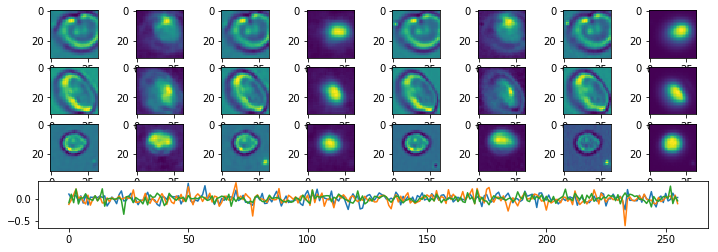

Epoch:  29 Iteration:  0 Loss:  1.498999 0.86977196 0.0


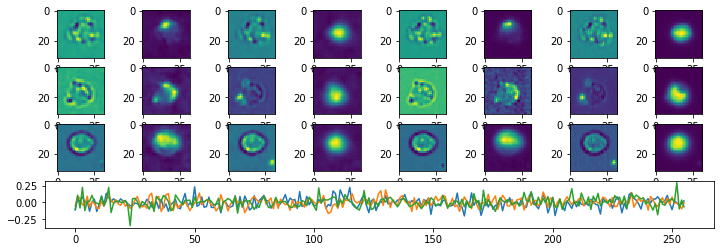

Epoch:  29 Iteration:  500 Loss:  1.5590491 0.92951393 0.0


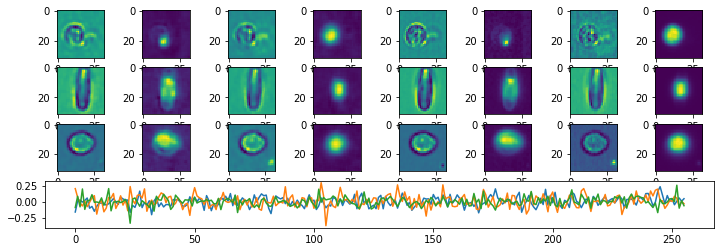

Epoch:  29 Iteration:  1000 Loss:  1.5127752 0.8832729 0.0


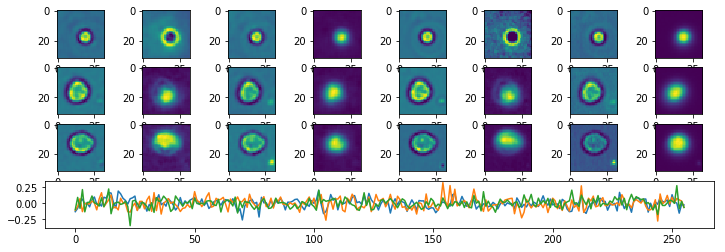

Epoch:  30 Iteration:  0 Loss:  1.4720398 0.8428271 0.0


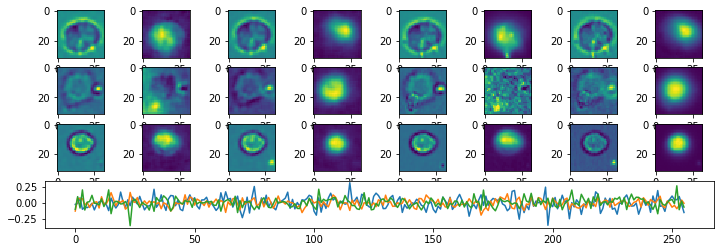

Epoch:  30 Iteration:  500 Loss:  1.5243351 0.89481837 0.0


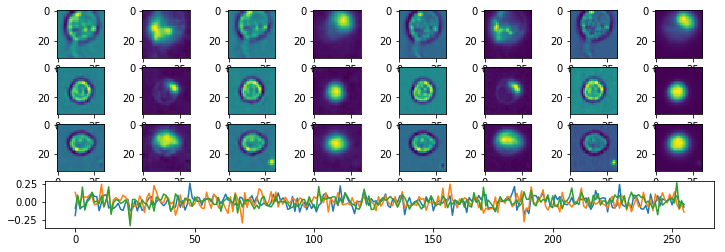

Epoch:  30 Iteration:  1000 Loss:  1.4939204 0.86442804 0.0


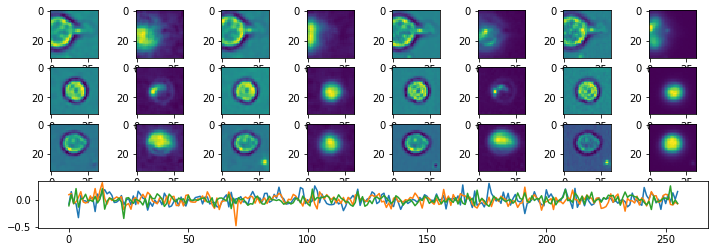

Epoch:  31 Iteration:  0 Loss:  1.4470093 0.8178101 0.0


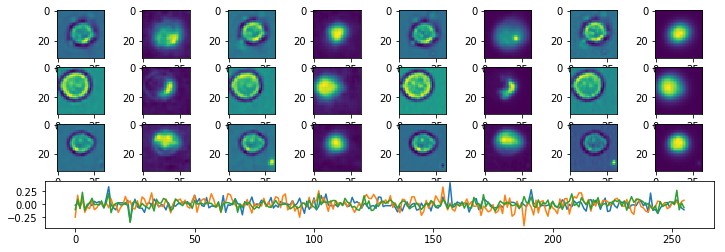

Epoch:  31 Iteration:  500 Loss:  1.5073514 0.8778437 0.0


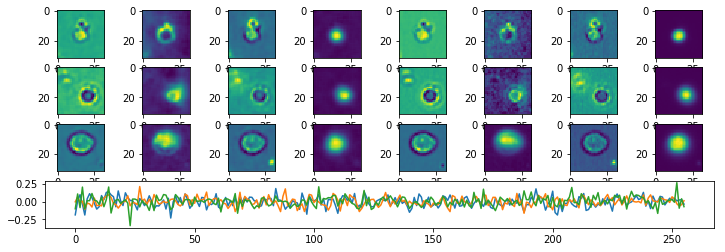

Epoch:  31 Iteration:  1000 Loss:  1.4806083 0.8511231 0.0


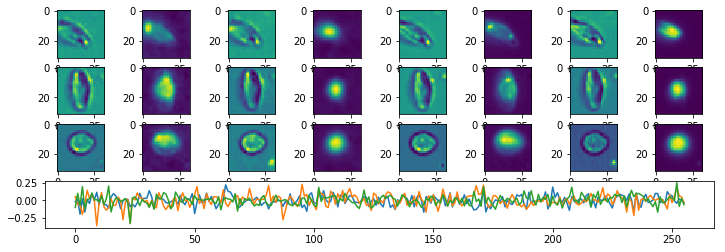

Epoch:  32 Iteration:  0 Loss:  1.4455284 0.8163303 0.0


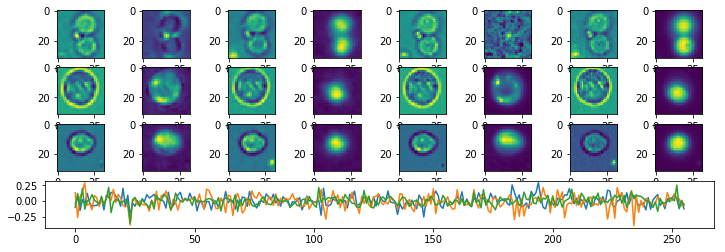

Epoch:  32 Iteration:  500 Loss:  1.4891305 0.85963213 0.0


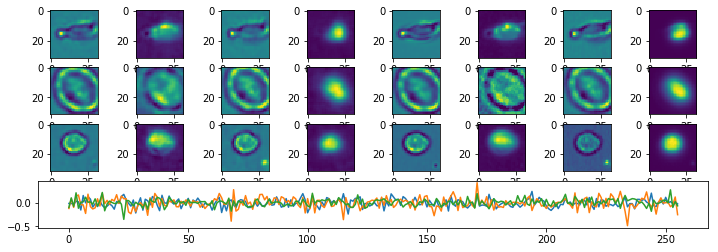

Epoch:  32 Iteration:  1000 Loss:  1.46818 0.83870107 0.0


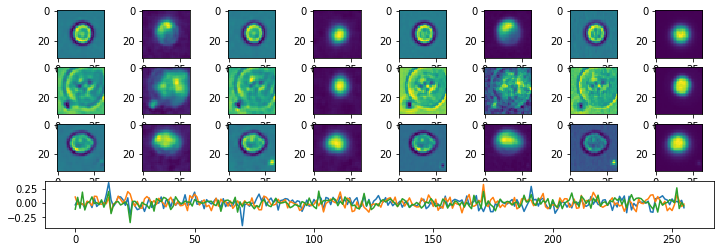

Epoch:  33 Iteration:  0 Loss:  1.4372407 0.80804604 0.0


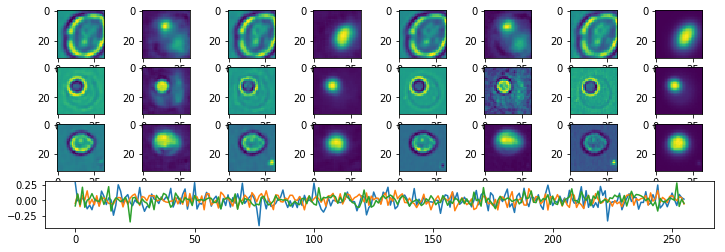

Epoch:  33 Iteration:  500 Loss:  1.4990678 0.869563 0.0


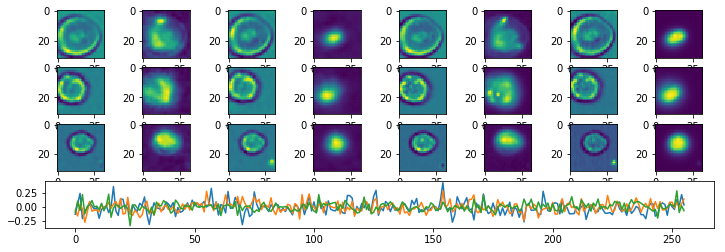

Epoch:  33 Iteration:  1000 Loss:  1.4604919 0.8310165 0.0


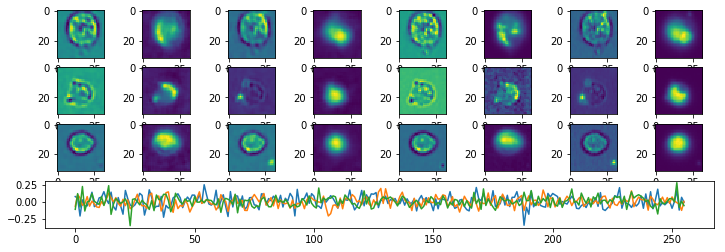

Epoch:  34 Iteration:  0 Loss:  1.4233376 0.7941507 0.0


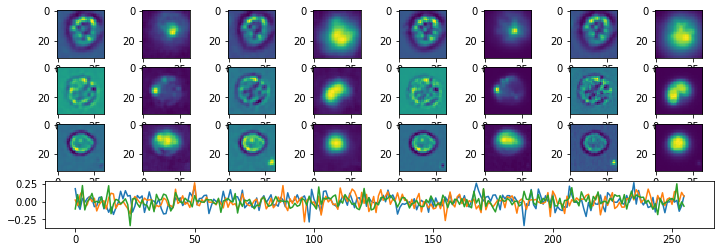

Epoch:  34 Iteration:  500 Loss:  1.4661176 0.8366309 0.0


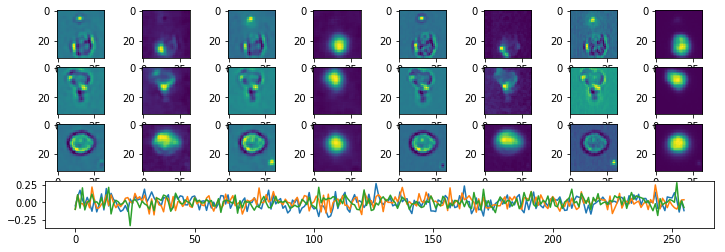

Epoch:  34 Iteration:  1000 Loss:  1.4425704 0.8131047 0.0


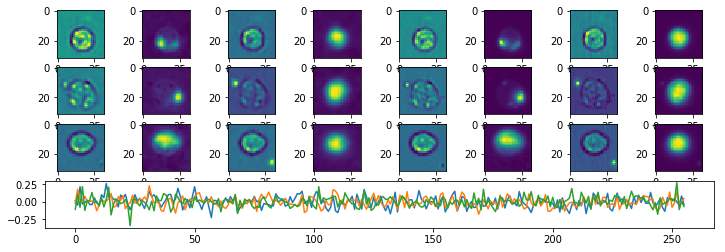

Epoch:  35 Iteration:  0 Loss:  1.4093466 0.780167 0.0


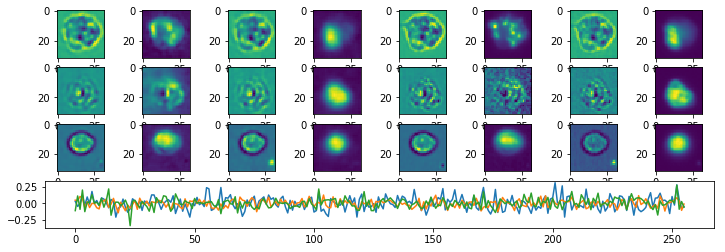

Epoch:  35 Iteration:  500 Loss:  1.4809887 0.85149324 0.0


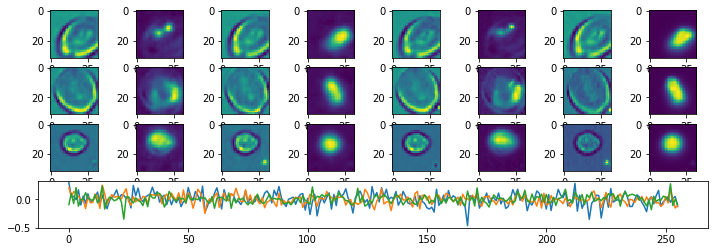

Epoch:  35 Iteration:  1000 Loss:  1.4240103 0.794555 0.0


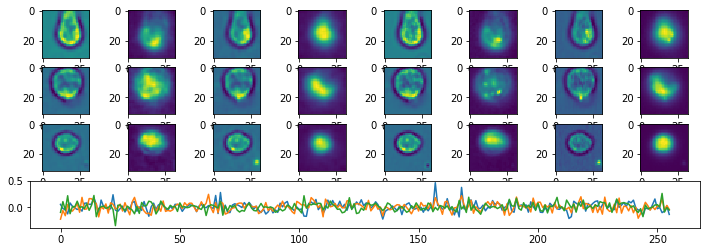

Epoch:  36 Iteration:  0 Loss:  1.4015481 0.7723725 0.0


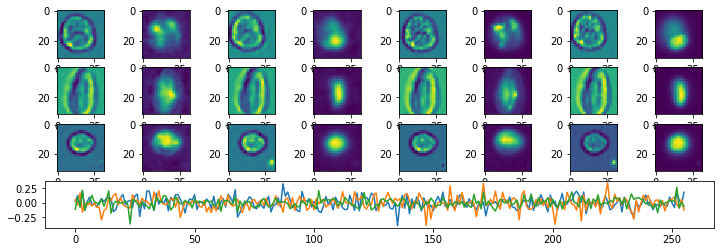

Epoch:  36 Iteration:  500 Loss:  1.4651058 0.83562005 0.0


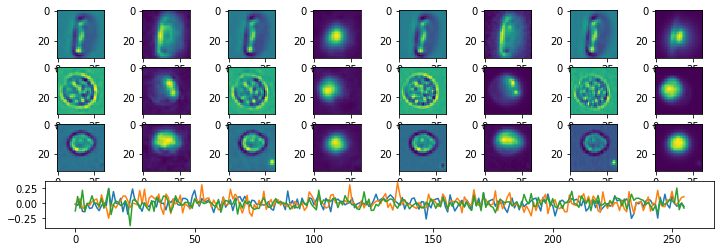

Epoch:  36 Iteration:  1000 Loss:  1.4192342 0.7897814 0.0


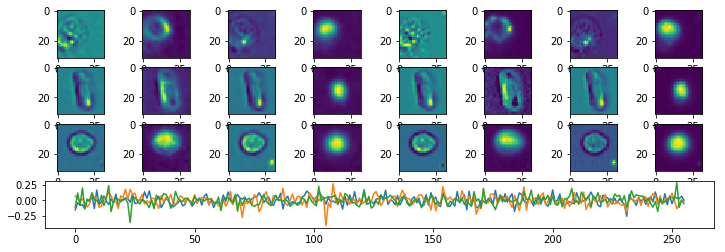

Epoch:  37 Iteration:  0 Loss:  1.3843688 0.7552024 0.0


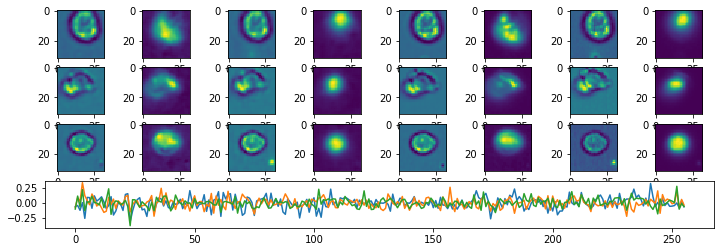

Epoch:  37 Iteration:  500 Loss:  1.4307344 0.8012664 0.0


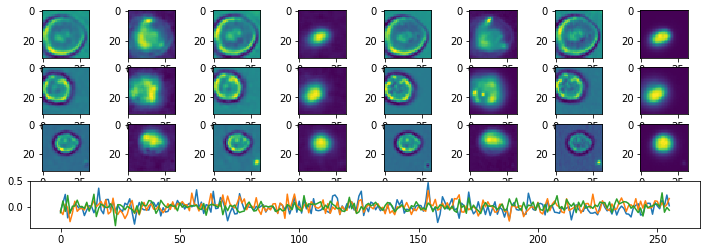

Epoch:  37 Iteration:  1000 Loss:  1.4072406 0.77779365 0.0


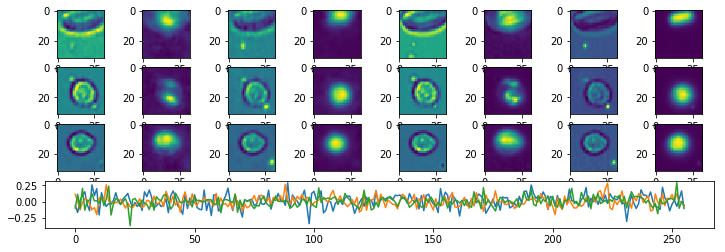

Epoch:  38 Iteration:  0 Loss:  1.3777087 0.74854577 0.0


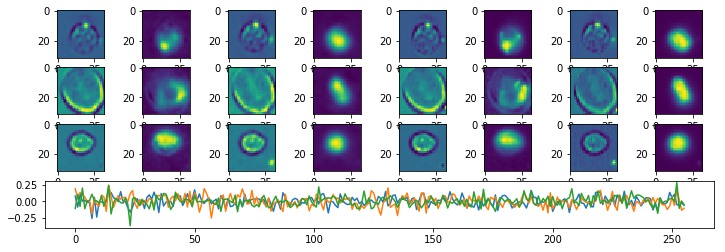

Epoch:  38 Iteration:  500 Loss:  1.4377799 0.80830836 0.0


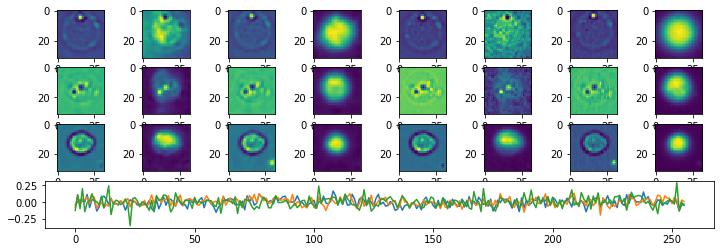

Epoch:  38 Iteration:  1000 Loss:  1.6156902 0.98613256 0.0


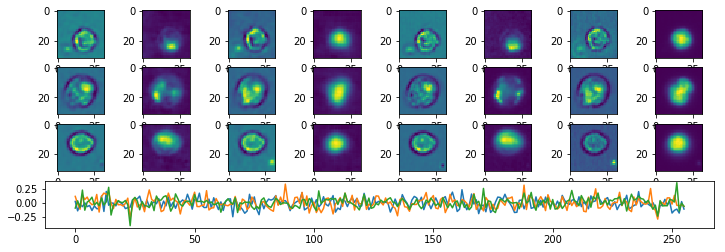

Epoch:  39 Iteration:  0 Loss:  1.4976282 0.86840135 0.0


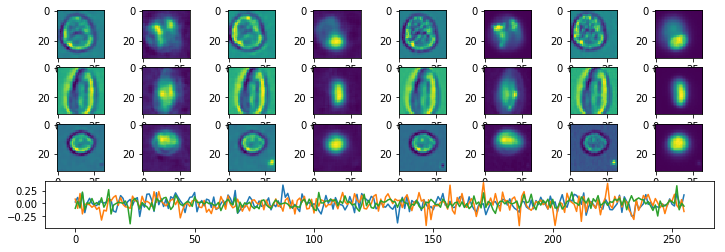

Epoch:  39 Iteration:  500 Loss:  1.5061169 0.8766091 0.0


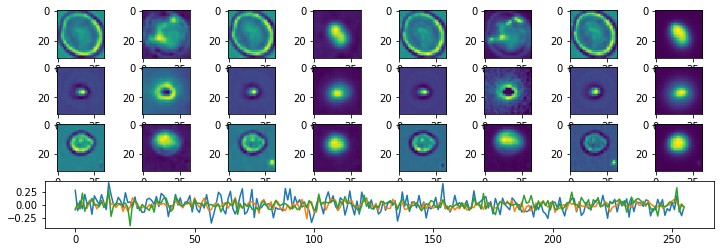

Epoch:  39 Iteration:  1000 Loss:  1.4555998 0.8261273 0.0


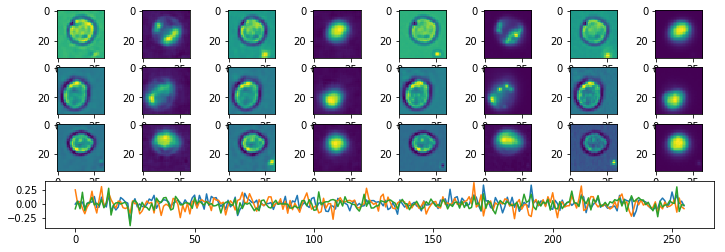

Epoch:  40 Iteration:  0 Loss:  1.4130316 0.7838502 0.0


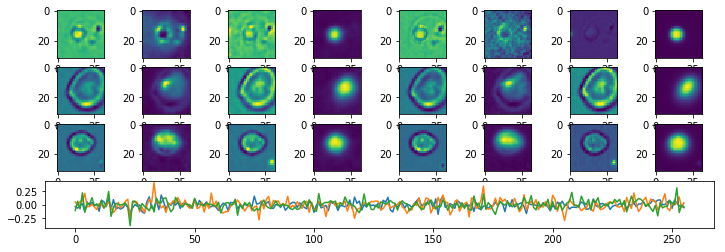

Epoch:  40 Iteration:  500 Loss:  1.453887 0.8244071 0.0


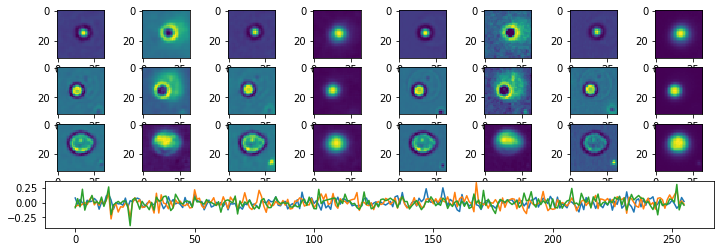

Epoch:  40 Iteration:  1000 Loss:  1.4176655 0.78821325 0.0


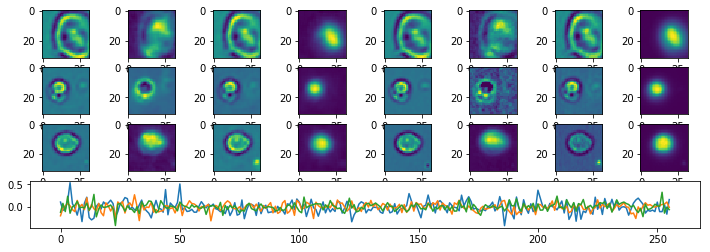

Epoch:  41 Iteration:  0 Loss:  1.3824849 0.7533196 0.0


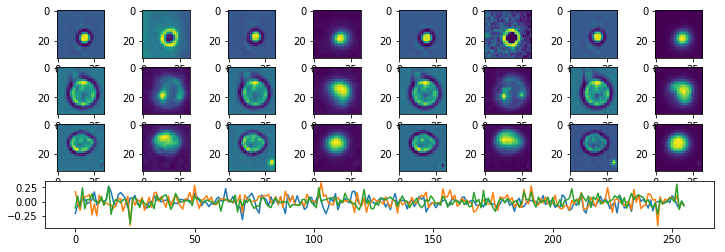

Epoch:  41 Iteration:  500 Loss:  1.4226389 0.79317546 0.0


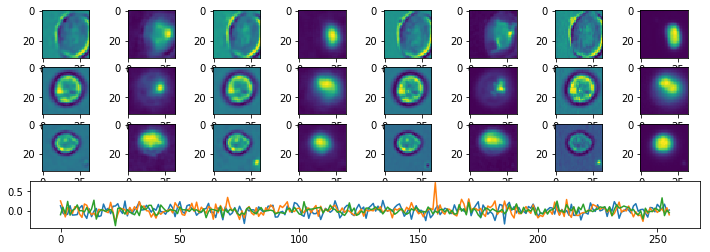

Epoch:  41 Iteration:  1000 Loss:  1.39825 0.7688081 0.0


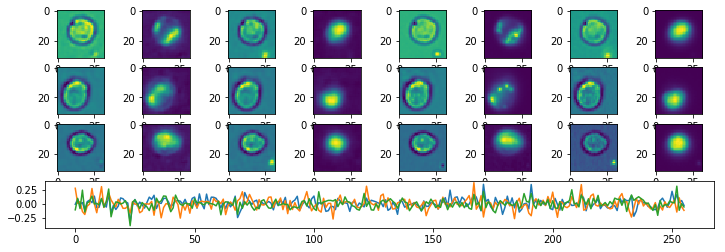

Epoch:  42 Iteration:  0 Loss:  1.3675928 0.73843575 0.0


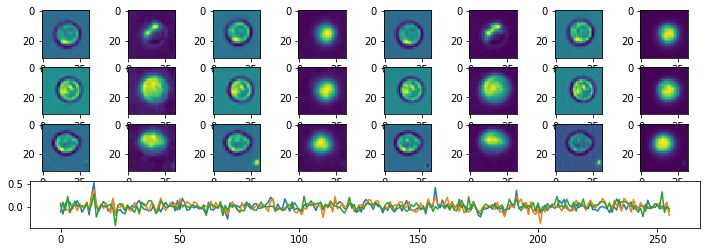

Epoch:  42 Iteration:  500 Loss:  1.409936 0.78047884 0.0


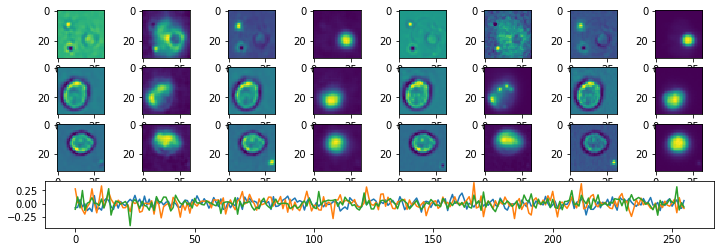

Epoch:  42 Iteration:  1000 Loss:  1.3904214 0.76098347 0.0


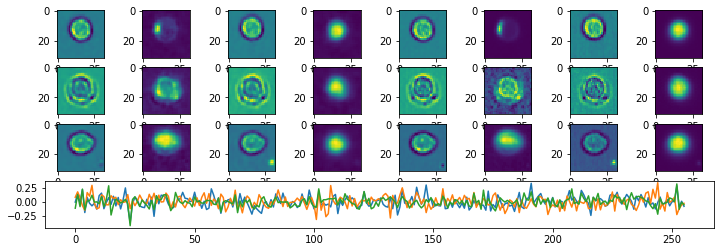

Epoch:  43 Iteration:  0 Loss:  1.3575292 0.72837716 0.0


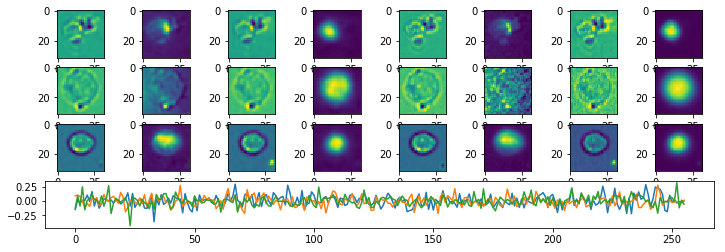

Epoch:  43 Iteration:  500 Loss:  1.4057543 0.7762994 0.0


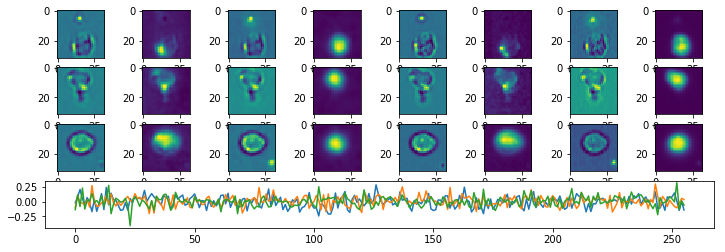

Epoch:  43 Iteration:  1000 Loss:  1.3874617 0.75802475 0.0


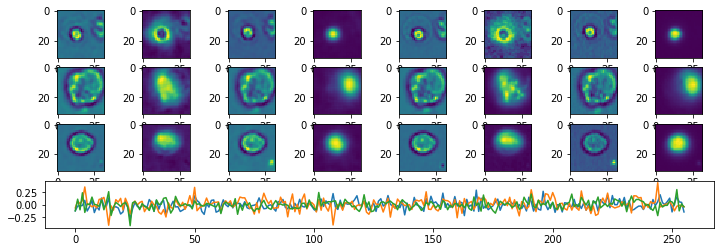

Epoch:  44 Iteration:  0 Loss:  1.3542763 0.7251258 0.0


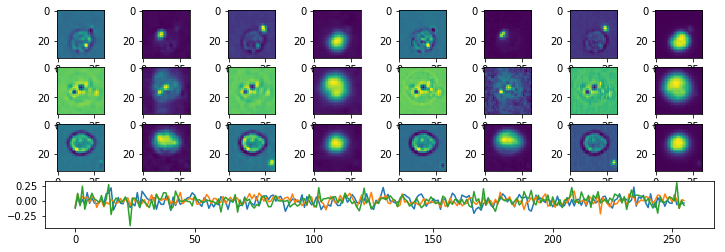

Epoch:  44 Iteration:  500 Loss:  1.4053015 0.77584624 0.0


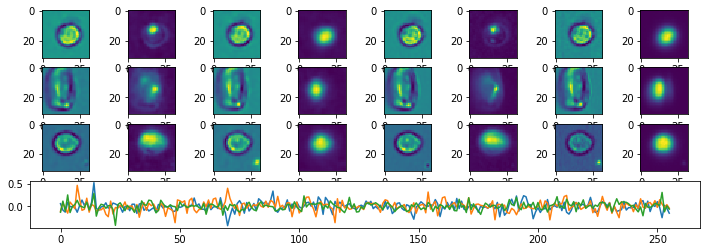

Epoch:  44 Iteration:  1000 Loss:  1.3696003 0.7401734 0.0


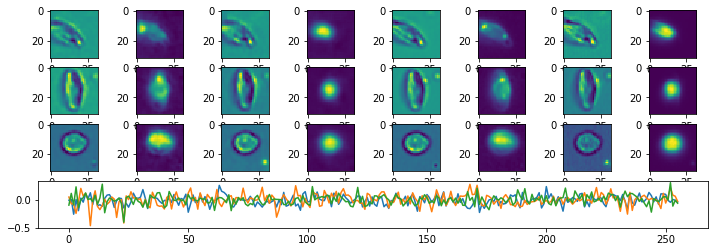

Epoch:  45 Iteration:  0 Loss:  1.3509986 0.72185016 0.0


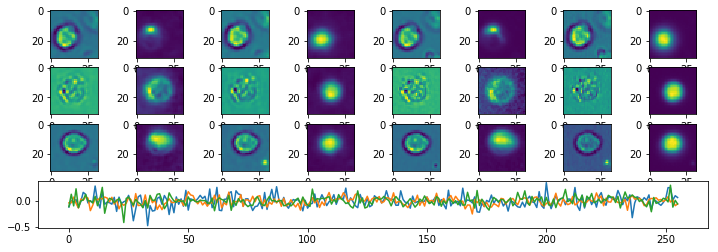

Epoch:  45 Iteration:  500 Loss:  1.4025555 0.77310216 0.0


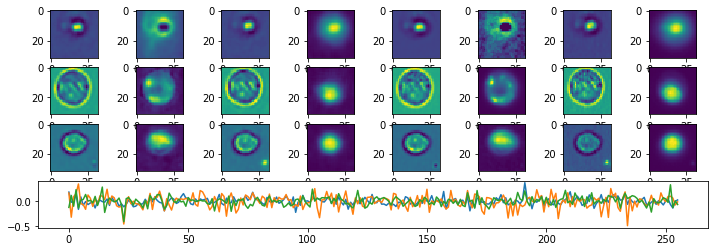

Epoch:  45 Iteration:  1000 Loss:  1.3578237 0.728403 0.0


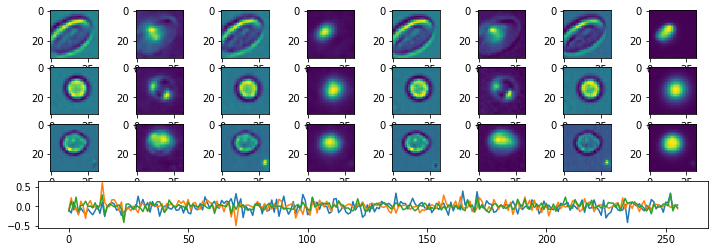

Epoch:  46 Iteration:  0 Loss:  1.3385122 0.70937026 0.0


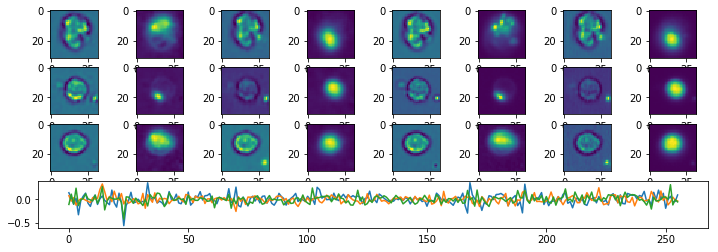

Epoch:  46 Iteration:  500 Loss:  1.4030305 0.77357745 0.0


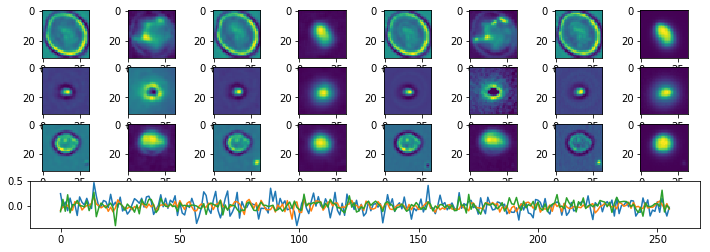

Epoch:  46 Iteration:  1000 Loss:  1.36228 0.73285675 0.0


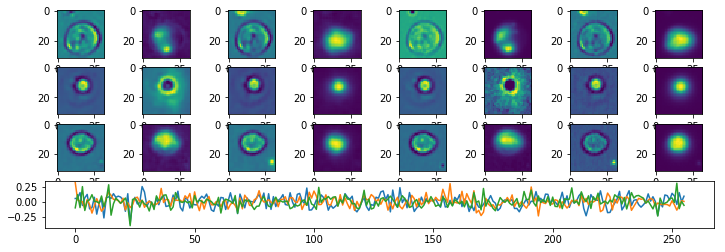

Epoch:  47 Iteration:  0 Loss:  1.3322186 0.7030803 0.0


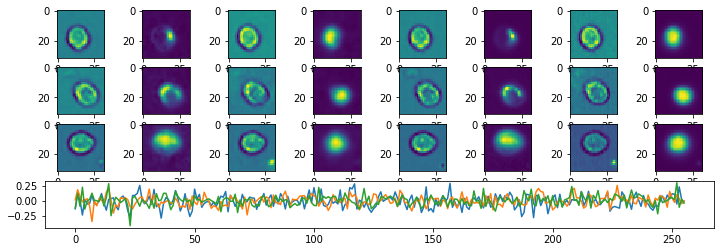

Epoch:  47 Iteration:  500 Loss:  1.3764534 0.7470139 0.0


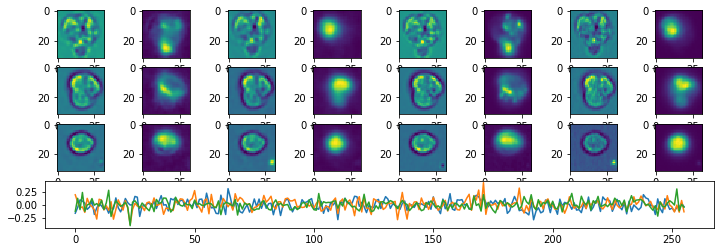

Epoch:  47 Iteration:  1000 Loss:  1.603807 0.9742563 0.0


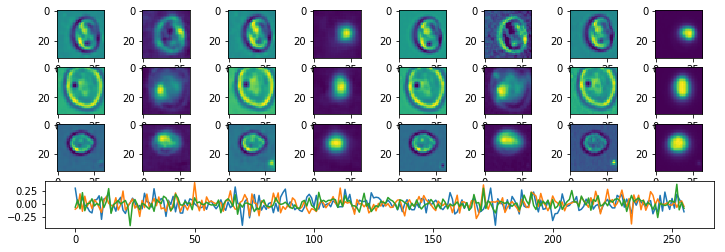

Epoch:  48 Iteration:  0 Loss:  1.4781501 0.84893394 0.0


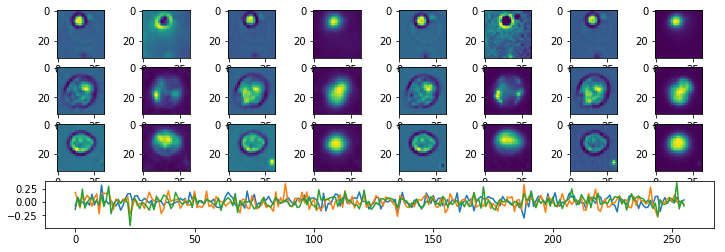

Epoch:  48 Iteration:  500 Loss:  1.470616 0.8411266 0.0


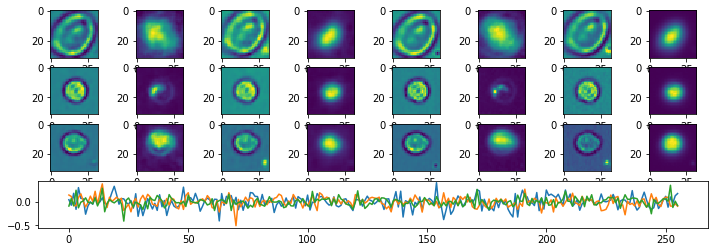

Epoch:  48 Iteration:  1000 Loss:  1.4383724 0.80890846 0.0


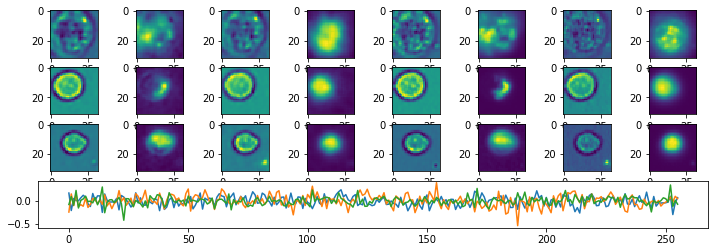

Epoch:  49 Iteration:  0 Loss:  1.3880868 0.75891817 0.0


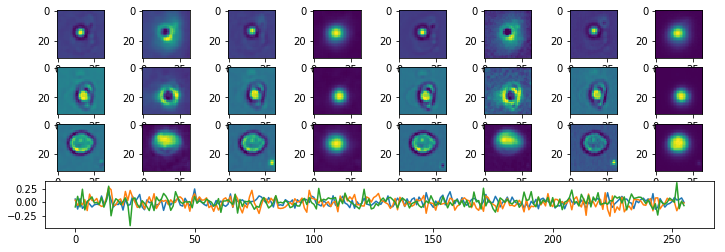

Epoch:  49 Iteration:  500 Loss:  1.4112741 0.7818154 0.0


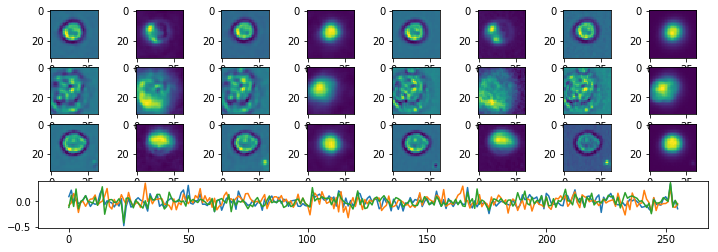

Epoch:  49 Iteration:  1000 Loss:  1.390299 0.7608604 0.0


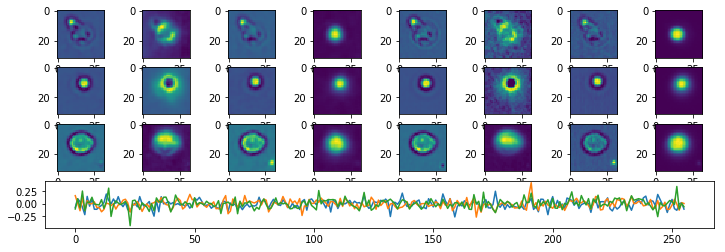

Epoch:  50 Iteration:  0 Loss:  1.3550746 0.7259236 0.0


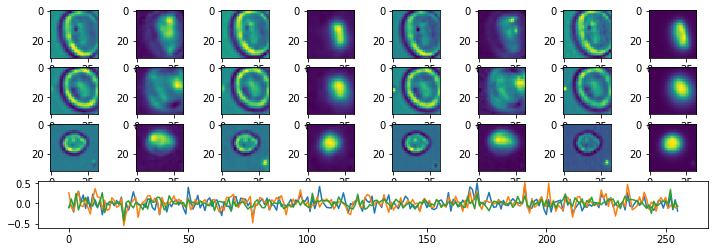

Epoch:  50 Iteration:  500 Loss:  1.386059 0.7566136 0.0


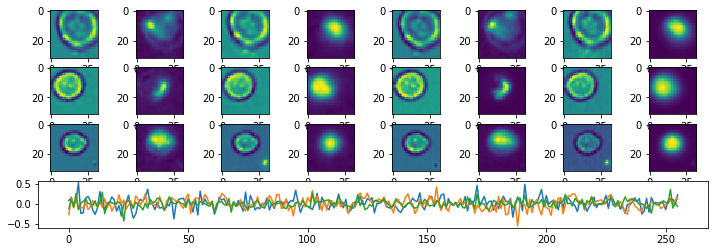

Epoch:  50 Iteration:  1000 Loss:  1.365233 0.7358078 0.0


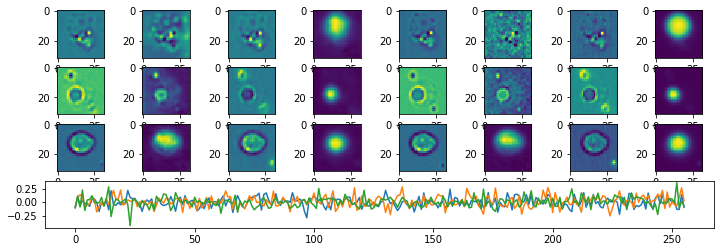

Epoch:  51 Iteration:  0 Loss:  1.3301585 0.7010205 0.0


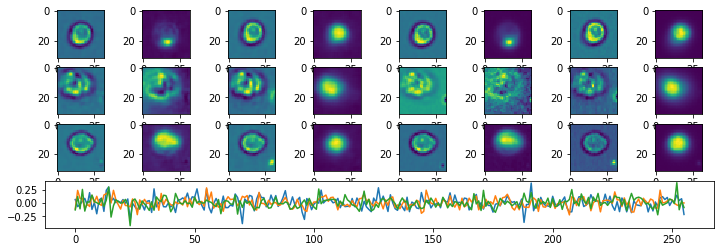

Epoch:  51 Iteration:  500 Loss:  1.378108 0.748667 0.0


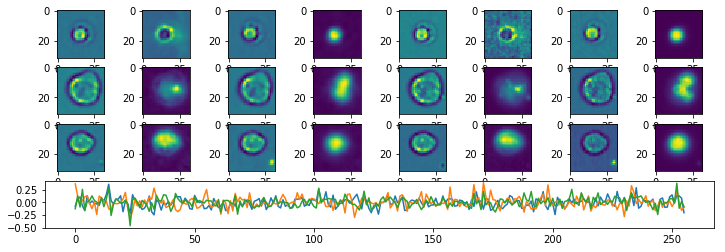

Epoch:  51 Iteration:  1000 Loss:  1.3530531 0.7236345 0.0


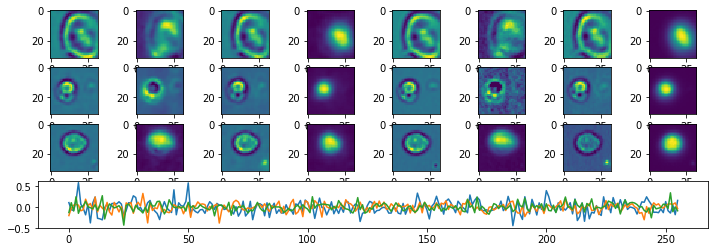

Epoch:  52 Iteration:  0 Loss:  1.3197541 0.690622 0.0


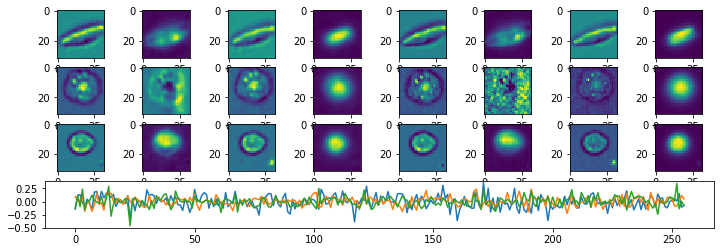

Epoch:  52 Iteration:  500 Loss:  1.3694311 0.7399951 0.0


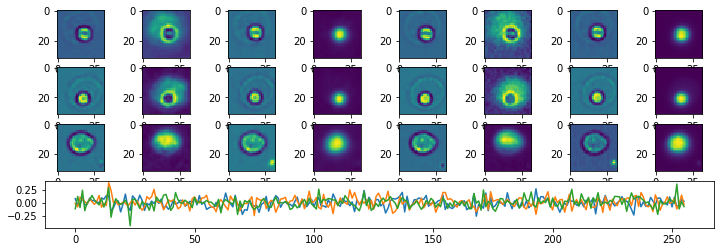

Epoch:  52 Iteration:  1000 Loss:  1.3362019 0.7067923 0.0


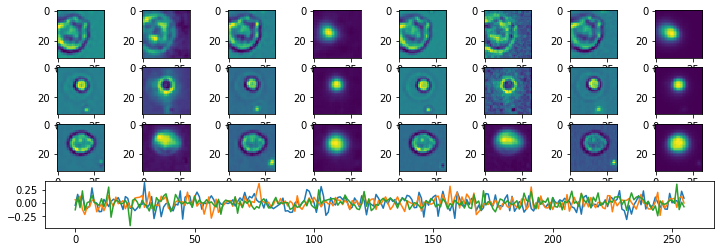

Epoch:  53 Iteration:  0 Loss:  1.3221111 0.69297814 0.0


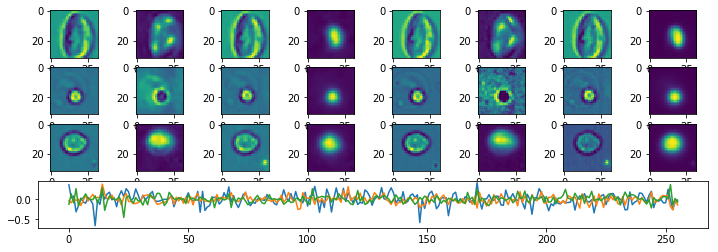

Epoch:  53 Iteration:  500 Loss:  1.3589275 0.72949696 0.0


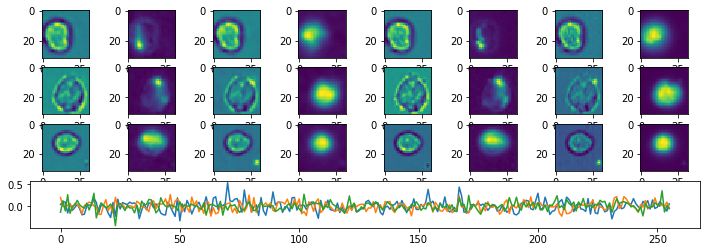

Epoch:  53 Iteration:  1000 Loss:  1.3389517 0.7095408 0.0


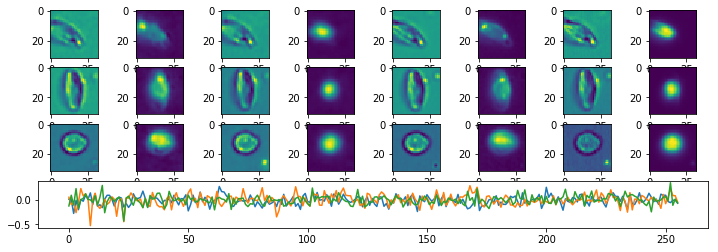

Epoch:  54 Iteration:  0 Loss:  1.3071761 0.678051 0.0


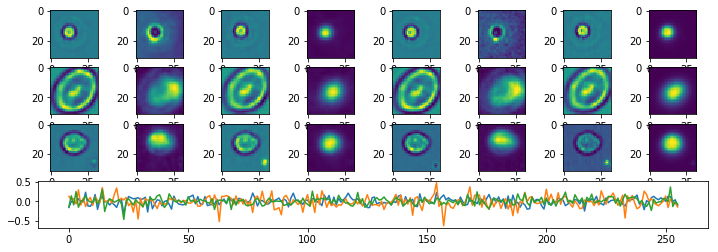

Epoch:  54 Iteration:  500 Loss:  1.3588228 0.72939247 0.0


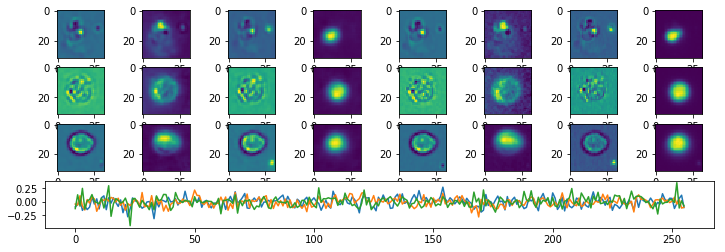

Epoch:  54 Iteration:  1000 Loss:  1.3314238 0.70201695 0.0


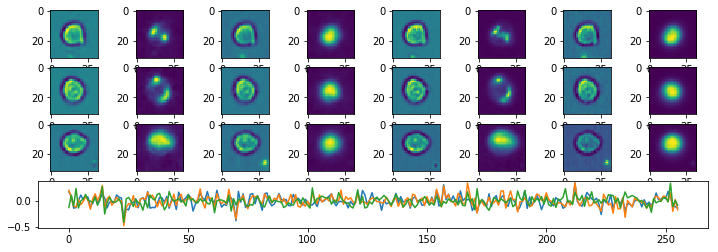

Epoch:  55 Iteration:  0 Loss:  1.3095751 0.68044835 0.0


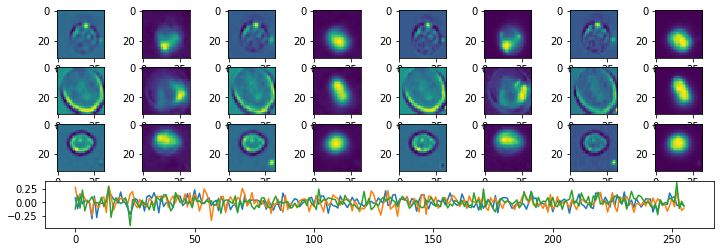

Epoch:  55 Iteration:  500 Loss:  1.3602731 0.73084193 0.0


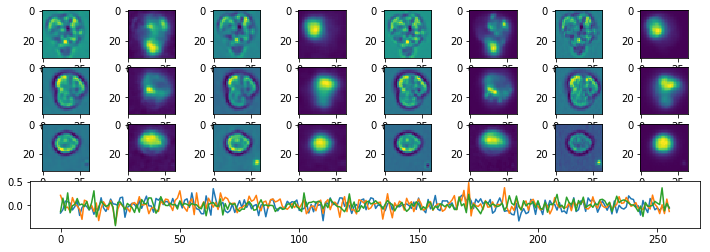

Epoch:  55 Iteration:  1000 Loss:  1.755733 1.1261034 0.0


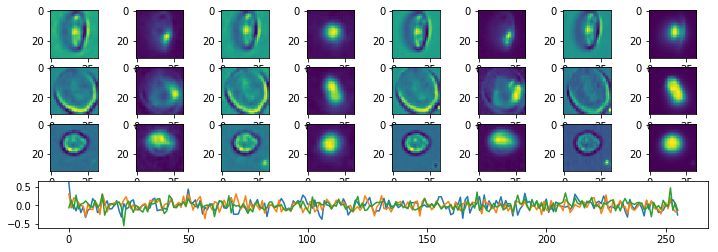

Epoch:  56 Iteration:  0 Loss:  1.5062858 0.87705517 0.0


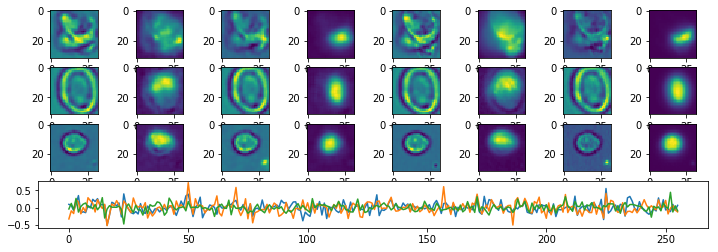

Epoch:  56 Iteration:  500 Loss:  1.4757429 0.846251 0.0


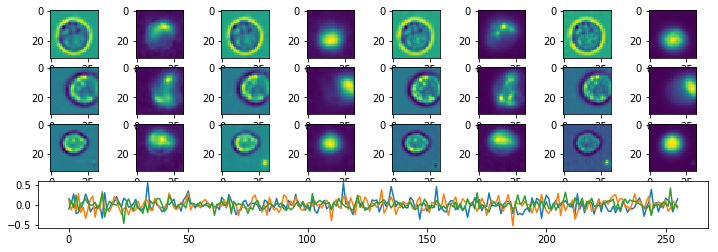

Epoch:  56 Iteration:  1000 Loss:  1.4082135 0.77876604 0.0


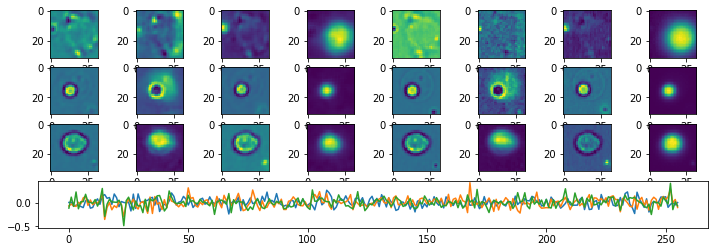

Epoch:  57 Iteration:  0 Loss:  1.3575735 0.7284214 0.0


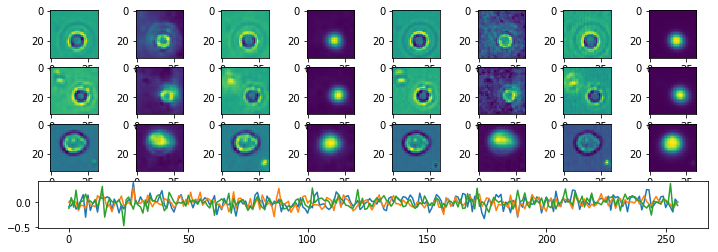

Epoch:  57 Iteration:  500 Loss:  1.3900412 0.7605938 0.0


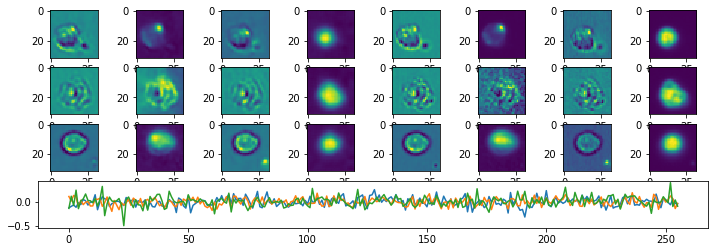

Epoch:  57 Iteration:  1000 Loss:  1.3553605 0.7259407 0.0


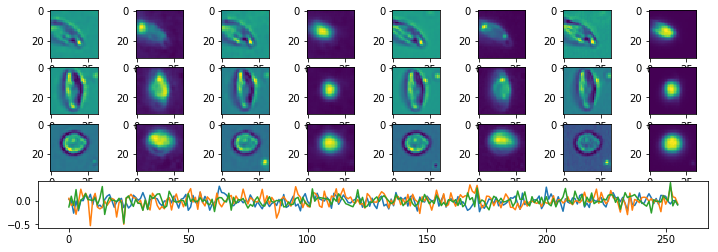

Epoch:  58 Iteration:  0 Loss:  1.3176019 0.6884711 0.0


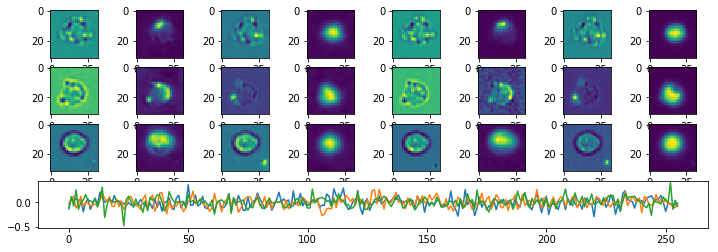

Epoch:  58 Iteration:  500 Loss:  1.3608534 0.73142195 0.0


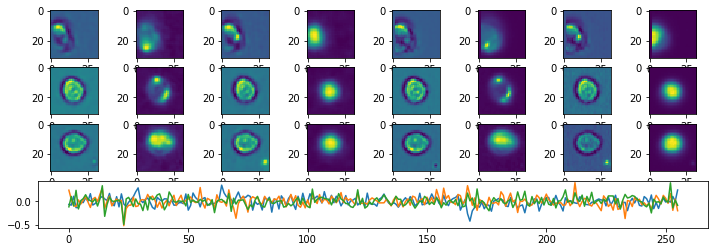

Epoch:  58 Iteration:  1000 Loss:  1.3338659 0.70445776 0.0


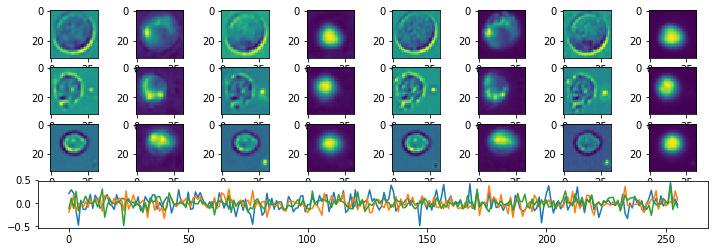

Epoch:  59 Iteration:  0 Loss:  1.3035573 0.67443395 0.0


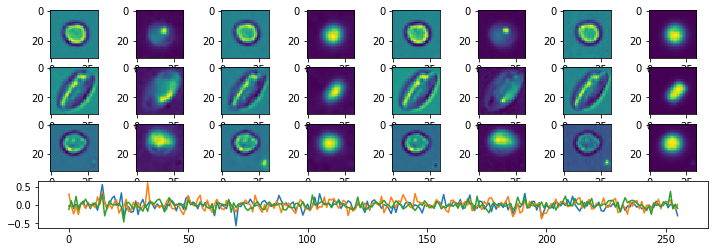

Epoch:  59 Iteration:  500 Loss:  1.3489366 0.719511 0.0


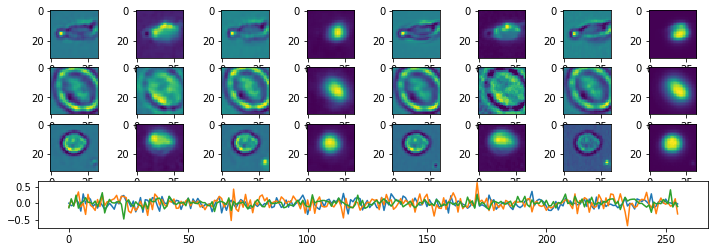

Epoch:  59 Iteration:  1000 Loss:  1.3234138 0.69401115 0.0


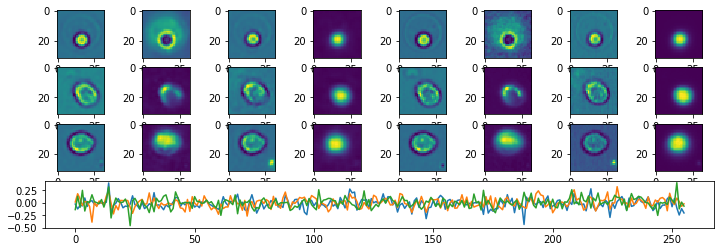

Epoch:  60 Iteration:  0 Loss:  1.2993264 0.67020524 0.0


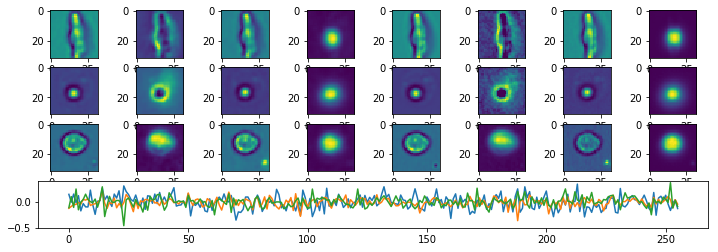

Epoch:  60 Iteration:  500 Loss:  1.3461034 0.71667975 0.0


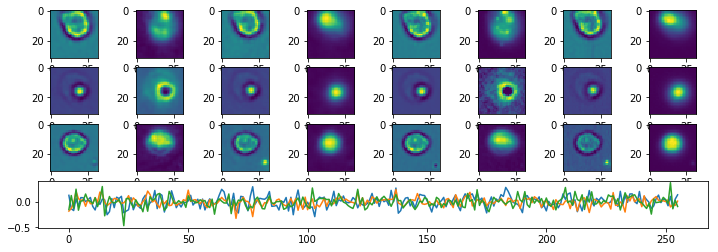

Epoch:  60 Iteration:  1000 Loss:  1.3231139 0.6937113 0.0


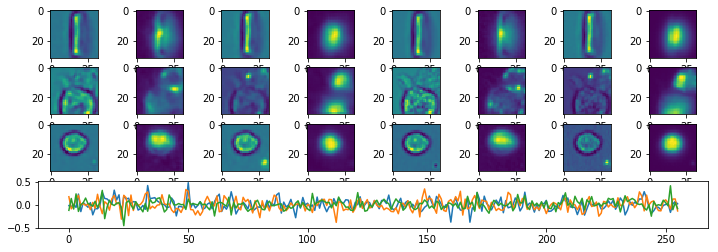

Epoch:  61 Iteration:  0 Loss:  1.2926654 0.6635479 0.0


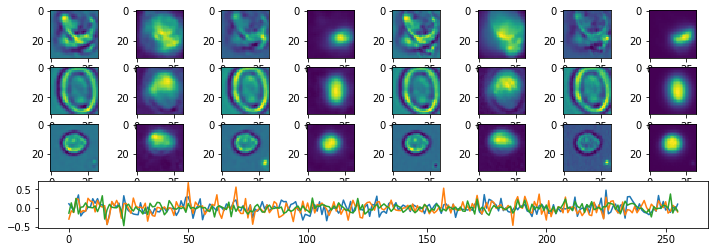

Epoch:  61 Iteration:  500 Loss:  1.3434844 0.7140614 0.0


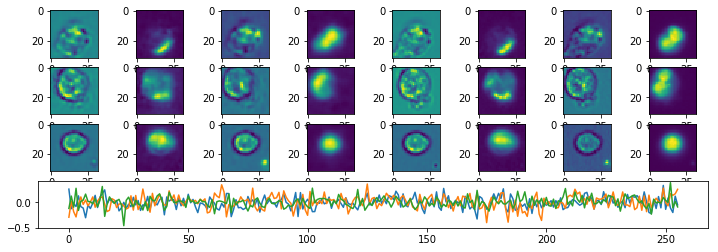

Epoch:  61 Iteration:  1000 Loss:  1.3156409 0.68624264 0.0


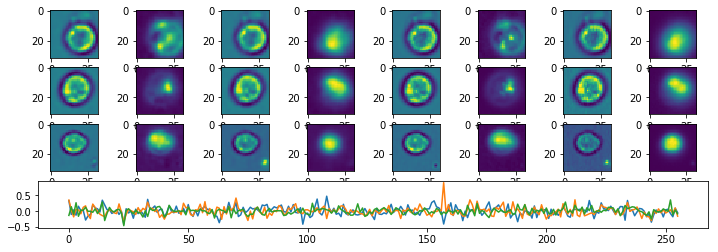

Epoch:  62 Iteration:  0 Loss:  1.2872319 0.65811723 0.0


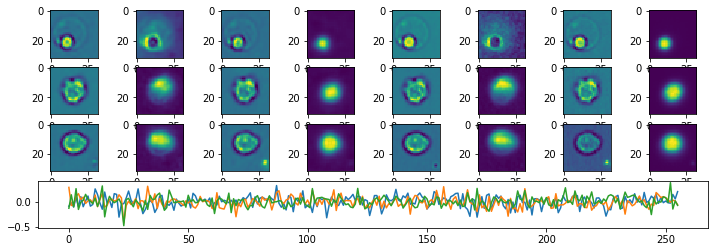

Epoch:  62 Iteration:  500 Loss:  1.3336872 0.70427 0.0


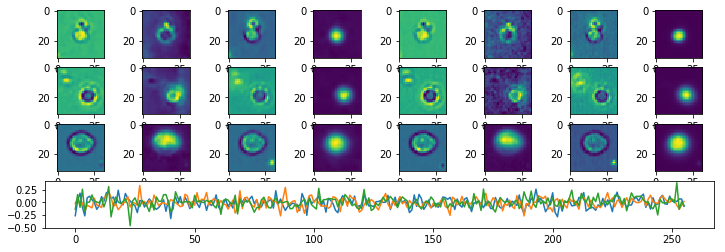

Epoch:  62 Iteration:  1000 Loss:  1.3115494 0.682153 0.0


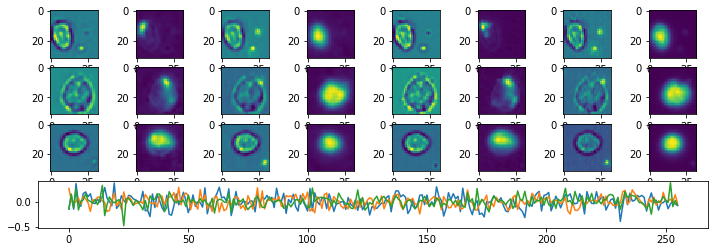

Epoch:  63 Iteration:  0 Loss:  1.2837629 0.6546504 0.0


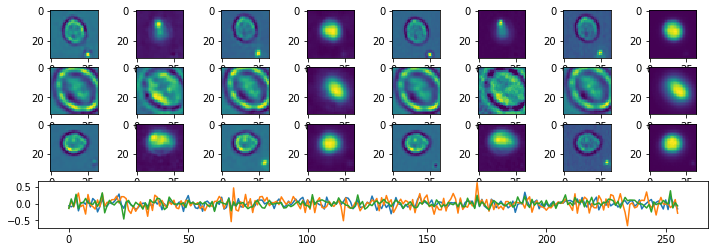

Epoch:  63 Iteration:  500 Loss:  1.3234338 0.6940217 0.0


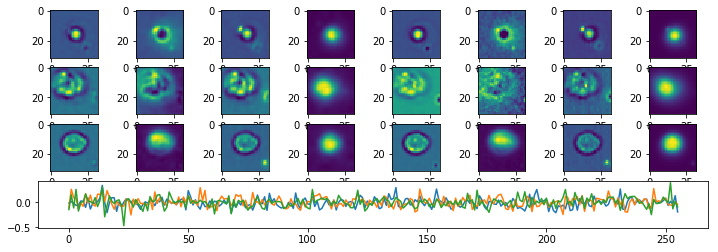

Epoch:  63 Iteration:  1000 Loss:  1.3115051 0.6821085 0.0


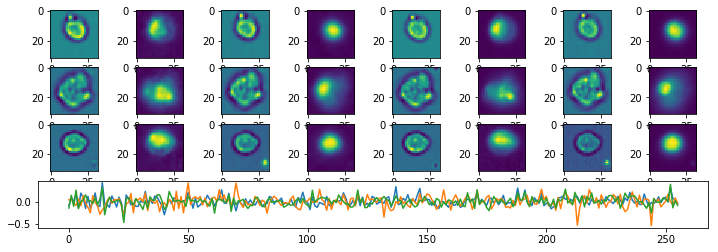

Epoch:  64 Iteration:  0 Loss:  1.2843868 0.6552737 0.0


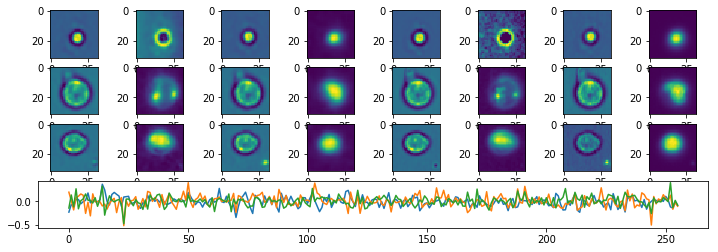

Epoch:  64 Iteration:  500 Loss:  1.3453894 0.71596634 0.0


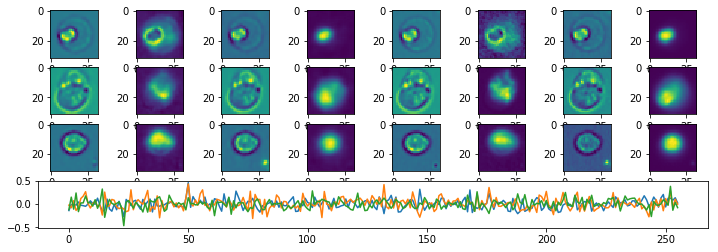

Epoch:  64 Iteration:  1000 Loss:  1.3038313 0.67443866 0.0


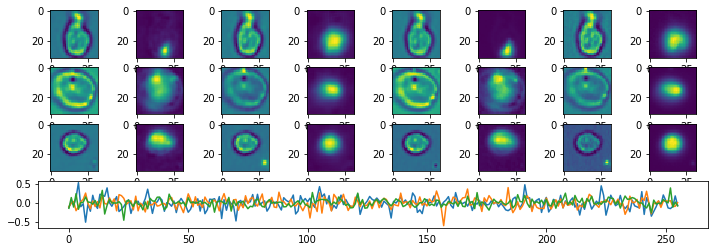

Epoch:  65 Iteration:  0 Loss:  1.2794203 0.6503099 0.0


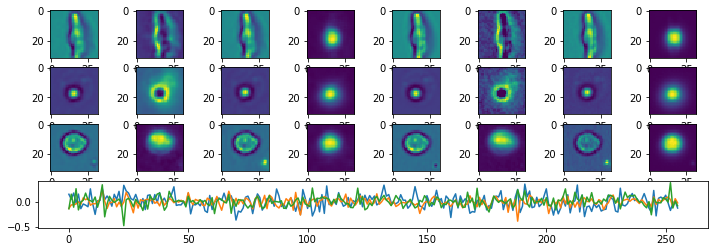

Epoch:  65 Iteration:  500 Loss:  1.3276174 0.6982032 0.0


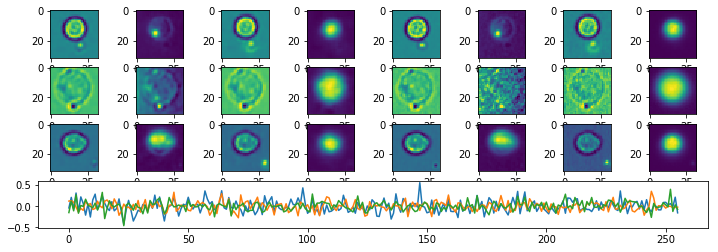

Epoch:  65 Iteration:  1000 Loss:  1.2973447 0.6679554 0.0


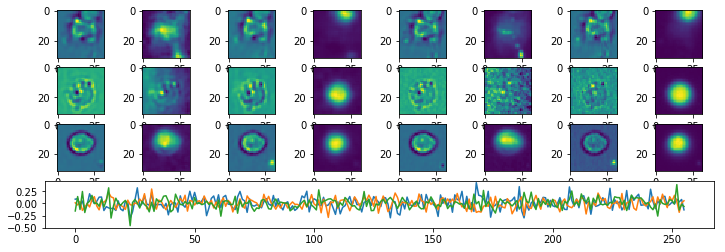

Epoch:  66 Iteration:  0 Loss:  1.2808218 0.65171075 0.0


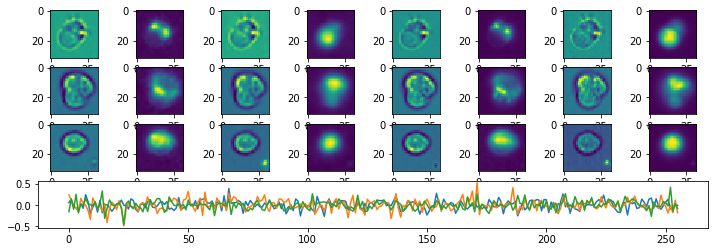

Epoch:  66 Iteration:  500 Loss:  1.3217154 0.6923043 0.0


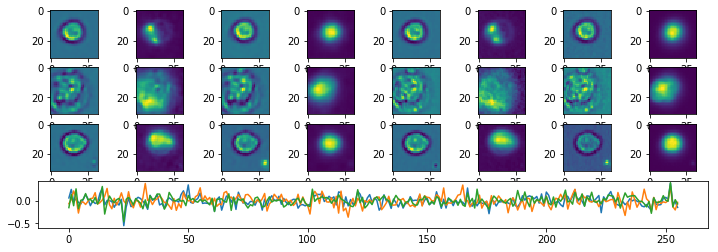

Epoch:  66 Iteration:  1000 Loss:  1.29403 0.6646423 0.0


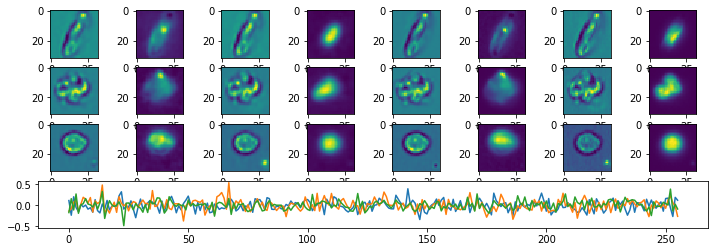

Epoch:  67 Iteration:  0 Loss:  1.2696846 0.6405792 0.0


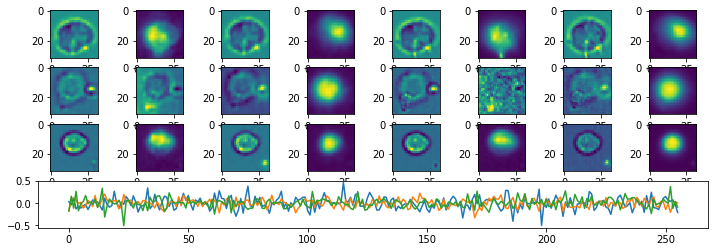

Epoch:  67 Iteration:  500 Loss:  1.3178396 0.68843055 0.0


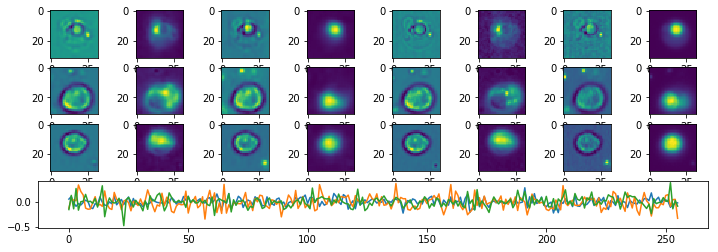

Epoch:  67 Iteration:  1000 Loss:  1.290576 0.66119033 0.0


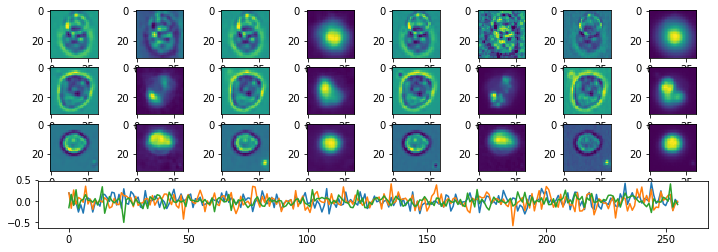

Epoch:  68 Iteration:  0 Loss:  1.2679499 0.6388459 0.0


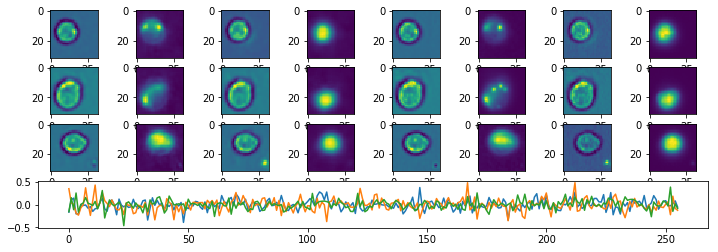

Epoch:  68 Iteration:  500 Loss:  1.3169484 0.6875396 0.0


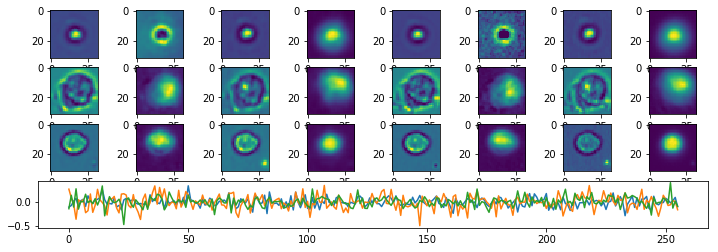

Epoch:  68 Iteration:  1000 Loss:  1.2873621 0.65797824 0.0


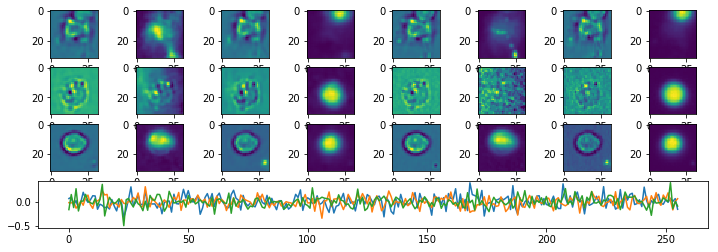

Epoch:  69 Iteration:  0 Loss:  1.2682555 0.6391511 0.0


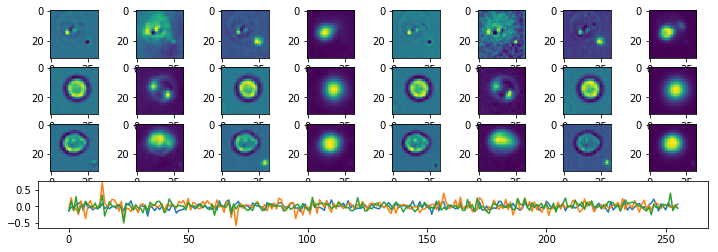

Epoch:  69 Iteration:  500 Loss:  1.3076017 0.6781968 0.0


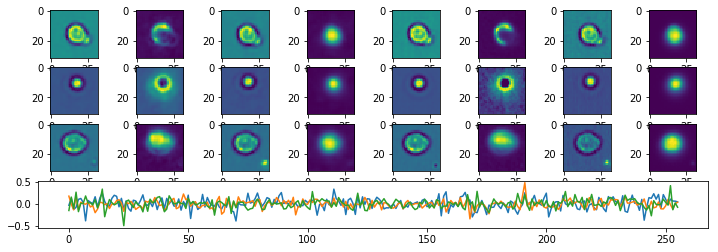

Epoch:  69 Iteration:  1000 Loss:  1.2799708 0.6505911 0.0


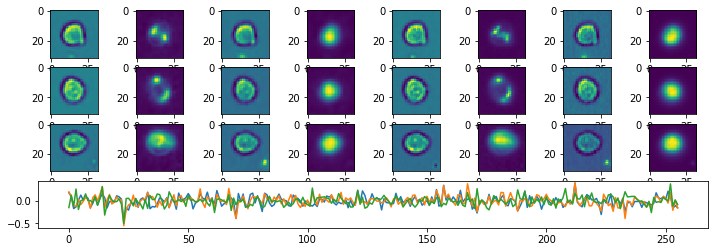

Epoch:  70 Iteration:  0 Loss:  1.2652373 0.6361345 0.0


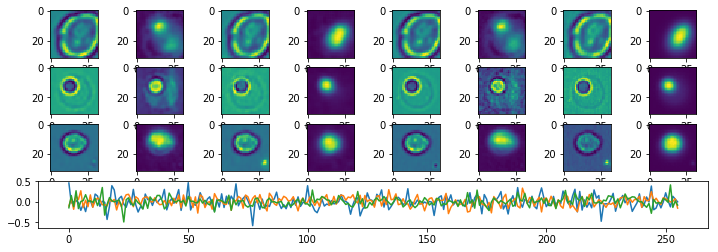

Epoch:  70 Iteration:  500 Loss:  1.3034737 0.6740722 0.0


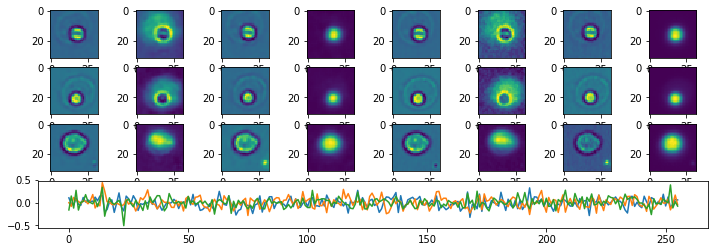

Epoch:  70 Iteration:  1000 Loss:  1.2823101 0.6529288 0.0


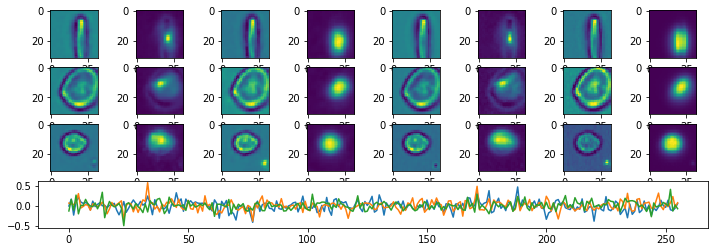

Epoch:  71 Iteration:  0 Loss:  1.2611157 0.63201493 0.0


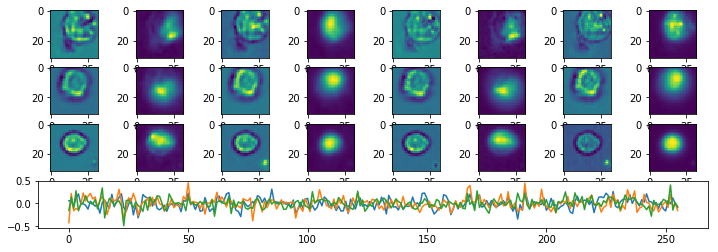

Epoch:  71 Iteration:  500 Loss:  3.2853394 2.6548948 0.0


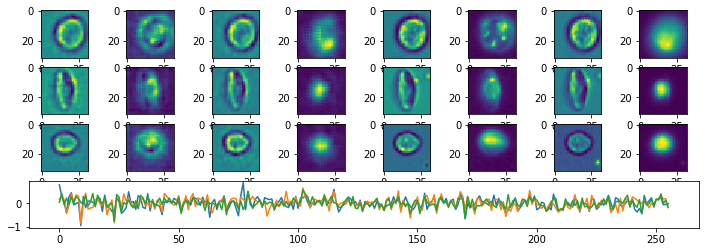

Epoch:  71 Iteration:  1000 Loss:  1.6323711 1.0028044 0.0


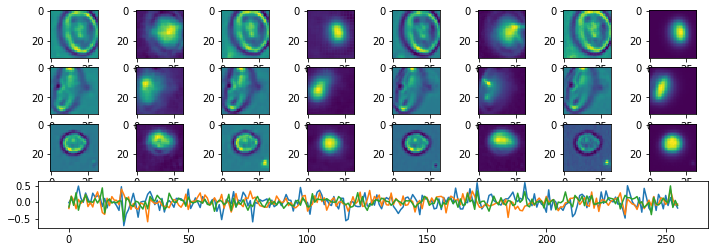

Epoch:  72 Iteration:  0 Loss:  1.4809027 0.8516847 0.0


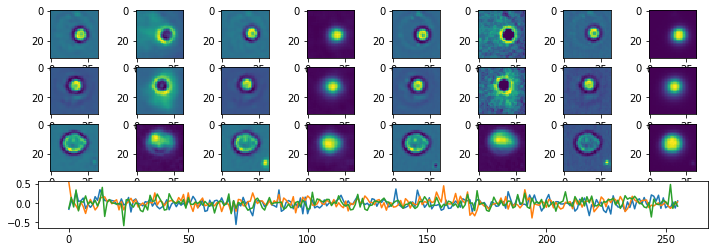

Epoch:  72 Iteration:  500 Loss:  1.4539623 0.82448125 0.0


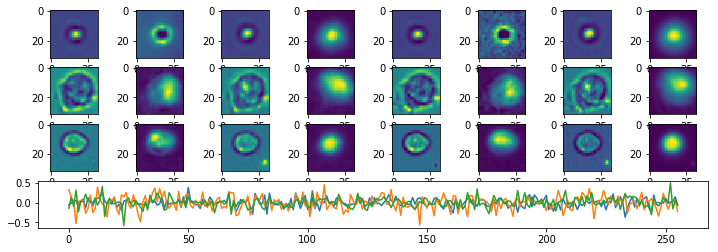

Epoch:  72 Iteration:  1000 Loss:  1.3783323 0.74889934 0.0


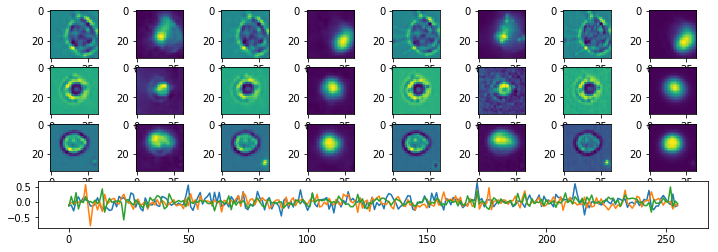

Epoch:  73 Iteration:  0 Loss:  1.3246953 0.6955595 0.0


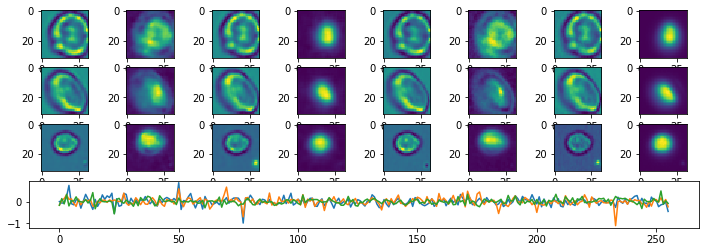

Epoch:  73 Iteration:  500 Loss:  1.3530234 0.72359526 0.0


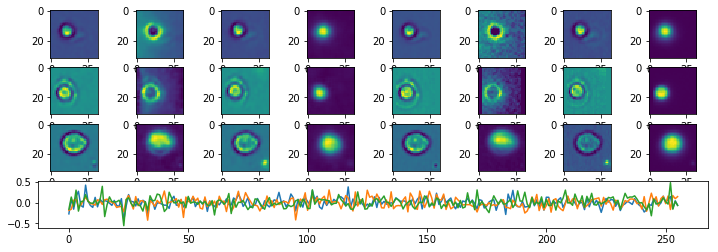

Epoch:  73 Iteration:  1000 Loss:  1.3122731 0.6828754 0.0


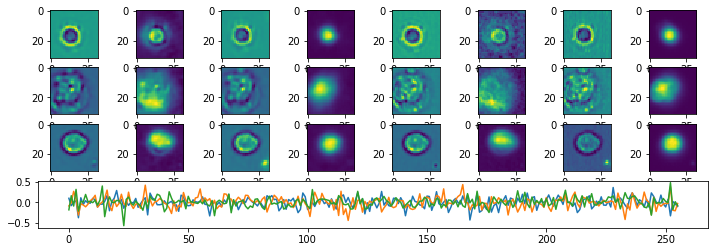

Epoch:  74 Iteration:  0 Loss:  1.2760954 0.64698607 0.0


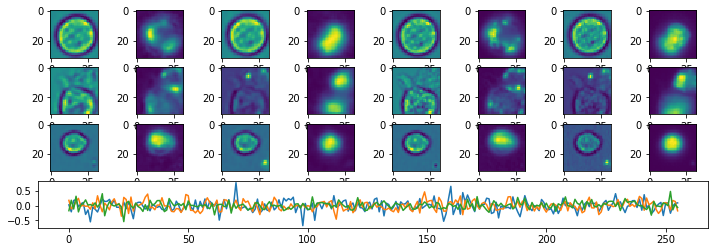

Epoch:  74 Iteration:  500 Loss:  1.3143377 0.68493056 0.0


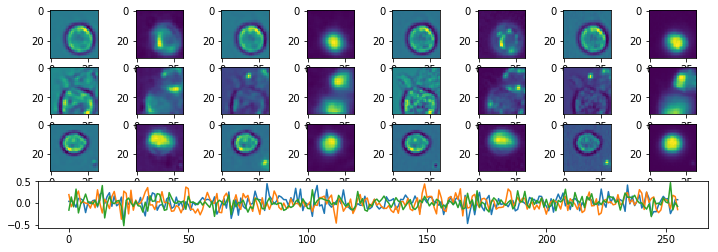

Epoch:  74 Iteration:  1000 Loss:  1.290638 0.6612518 0.0


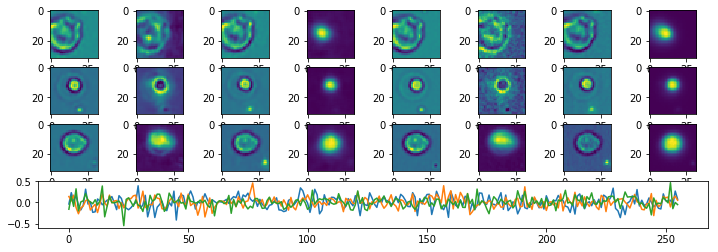

Epoch:  75 Iteration:  0 Loss:  1.2586939 0.6295945 0.0


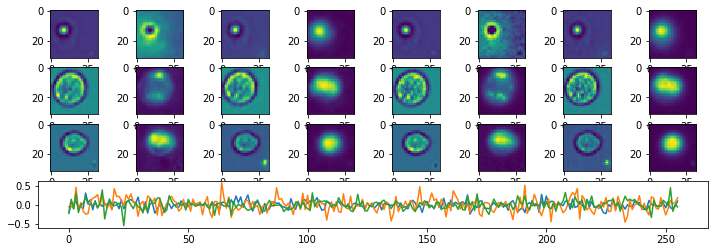

Epoch:  75 Iteration:  500 Loss:  1.3053943 0.6759912 0.0


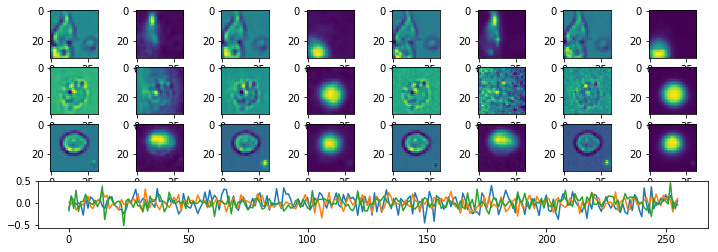

Epoch:  75 Iteration:  1000 Loss:  1.2845507 0.6551683 0.0


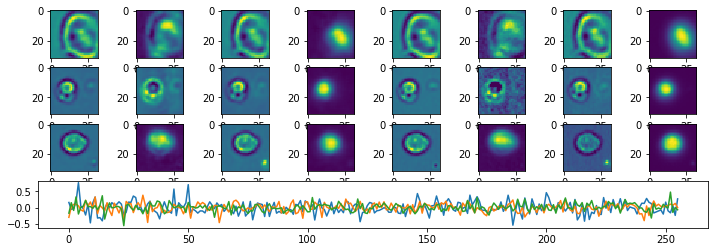

Epoch:  76 Iteration:  0 Loss:  1.2552952 0.6261976 0.0


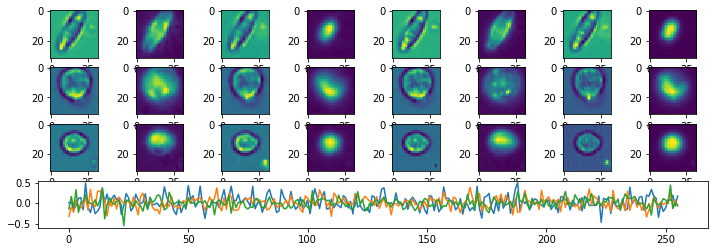

Epoch:  76 Iteration:  500 Loss:  1.309068 0.6796631 0.0


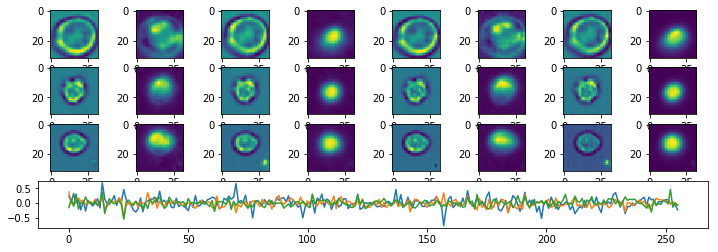

Epoch:  76 Iteration:  1000 Loss:  1.2707951 0.64141995 0.0


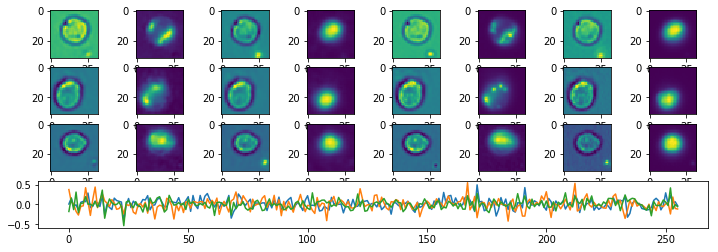

Epoch:  77 Iteration:  0 Loss:  1.2592485 0.6301489 0.0


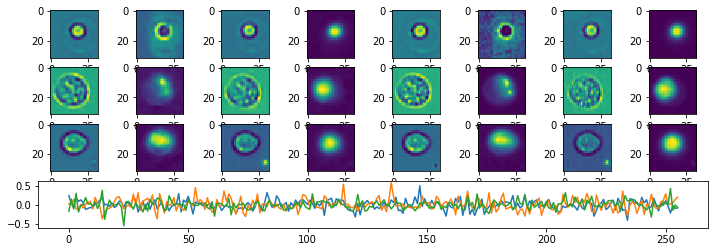

Epoch:  77 Iteration:  500 Loss:  1.3059 0.6764969 0.0


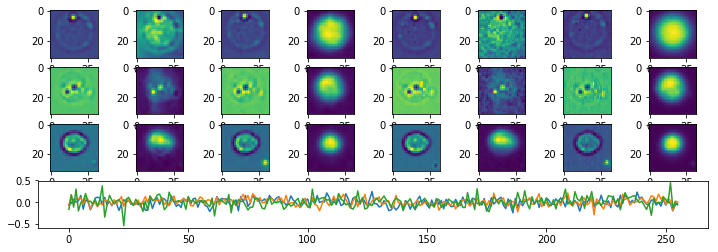

Epoch:  77 Iteration:  1000 Loss:  1.2708911 0.641516 0.0


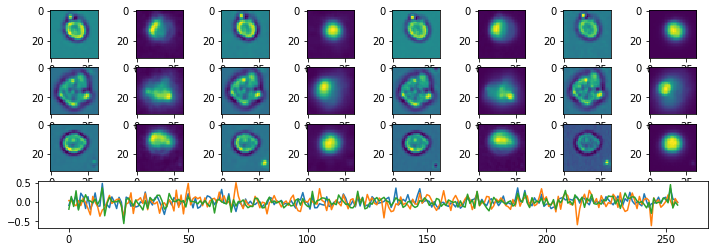

Epoch:  78 Iteration:  0 Loss:  1.2632964 0.63419443 0.0


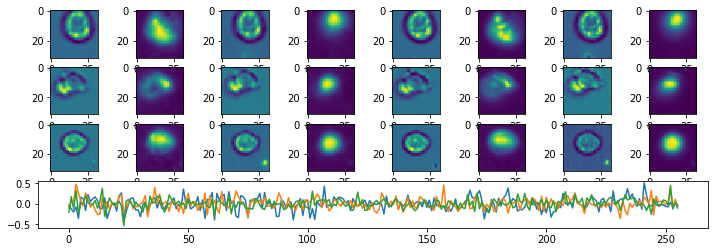

Epoch:  78 Iteration:  500 Loss:  1.3019342 0.67253315 0.0


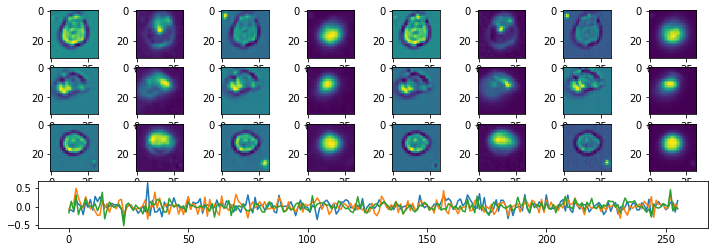

Epoch:  78 Iteration:  1000 Loss:  1.2724767 0.6431004 0.0


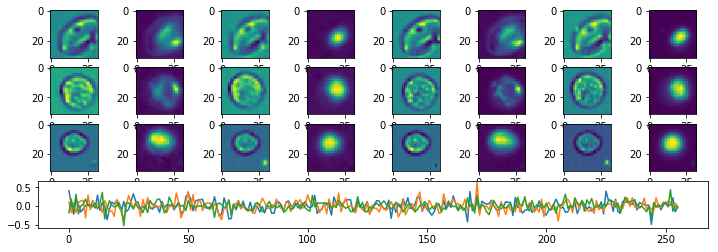

Epoch:  79 Iteration:  0 Loss:  1.2515721 0.62247634 0.0


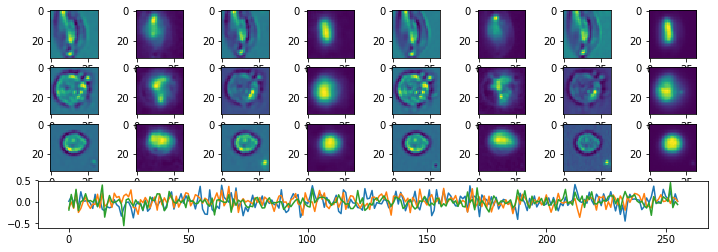

Epoch:  79 Iteration:  500 Loss:  1.3023523 0.6729506 0.0


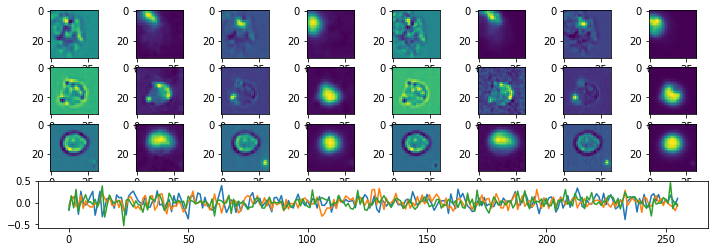

Epoch:  79 Iteration:  1000 Loss:  1.2781751 0.64879614 0.0


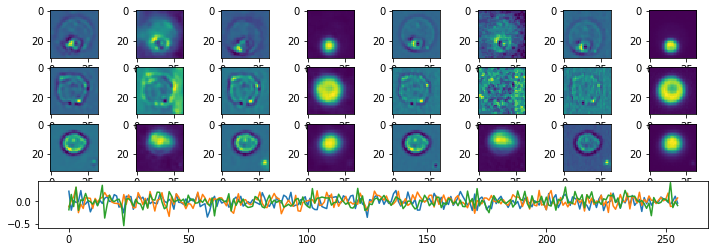

Epoch:  80 Iteration:  0 Loss:  1.2455666 0.61647433 0.0


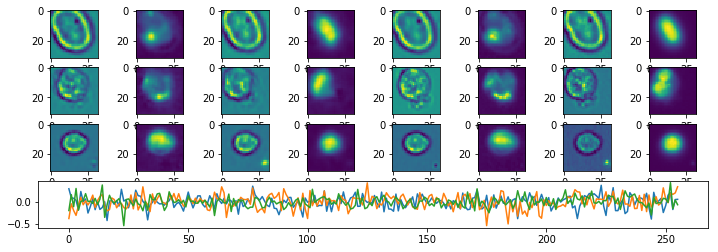

Epoch:  80 Iteration:  500 Loss:  1.2924935 0.6630976 0.0


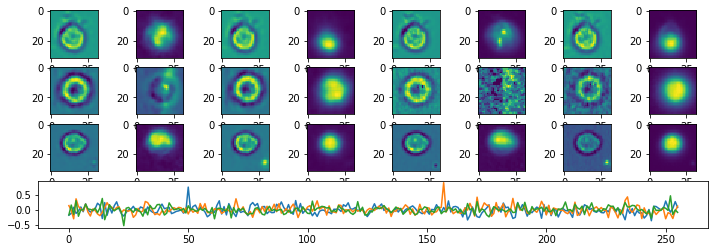

Epoch:  80 Iteration:  1000 Loss:  1.2673802 0.6380068 0.0


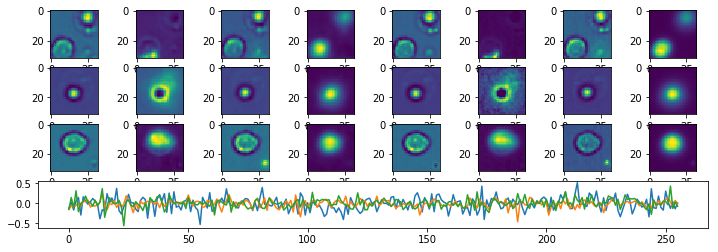

Epoch:  81 Iteration:  0 Loss:  1.2526739 0.62357783 0.0


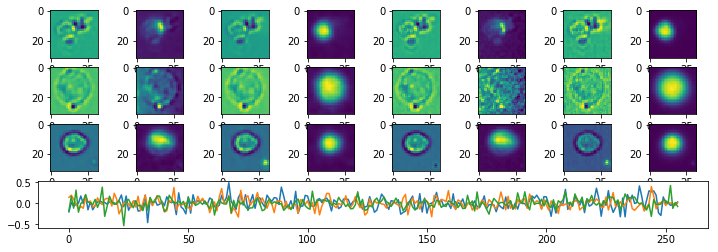

Epoch:  81 Iteration:  500 Loss:  1.2958555 0.6664578 0.0


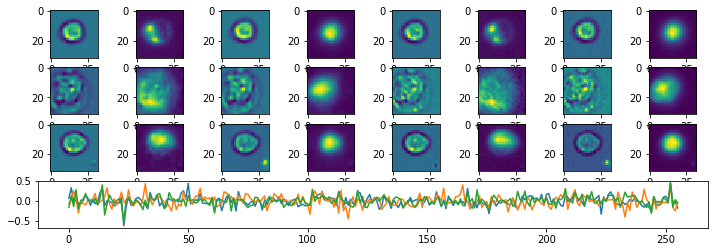

Epoch:  81 Iteration:  1000 Loss:  1.2662812 0.63690895 0.0


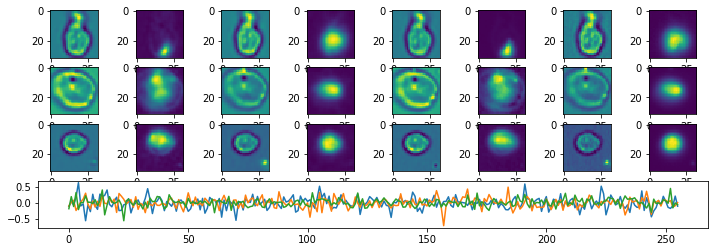

Epoch:  82 Iteration:  0 Loss:  1.2477152 0.6186215 0.0


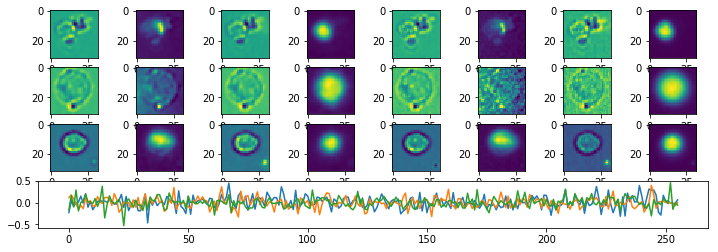

Epoch:  82 Iteration:  500 Loss:  3.1340914 2.5037272 0.0


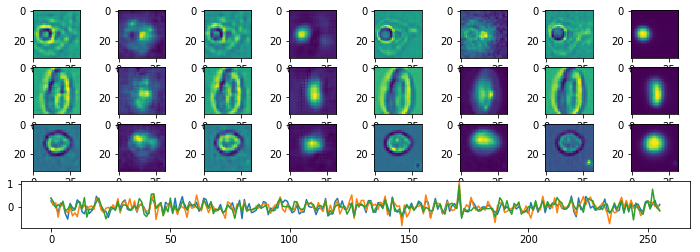

Epoch:  82 Iteration:  1000 Loss:  1.5408647 0.9113457 0.0


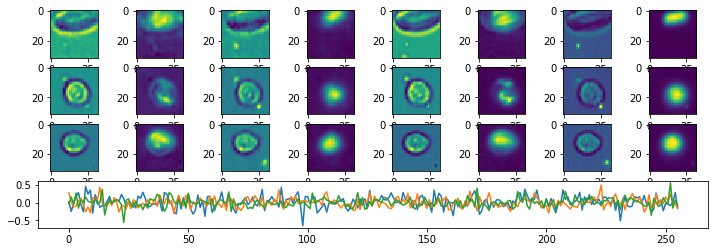

Epoch:  83 Iteration:  0 Loss:  1.407635 0.7784547 0.0


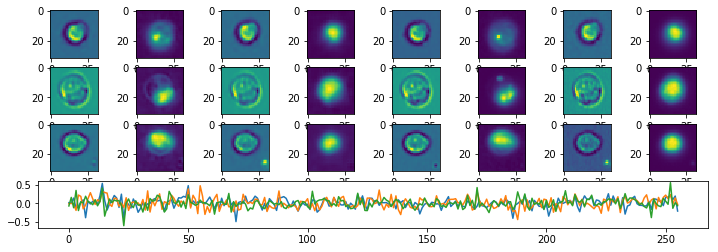

Epoch:  83 Iteration:  500 Loss:  1.395664 0.76621264 0.0


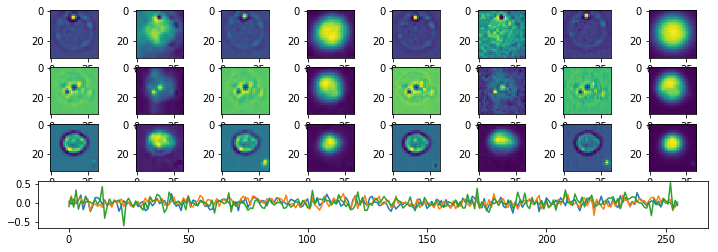

Epoch:  83 Iteration:  1000 Loss:  1.33481 0.7053998 0.0


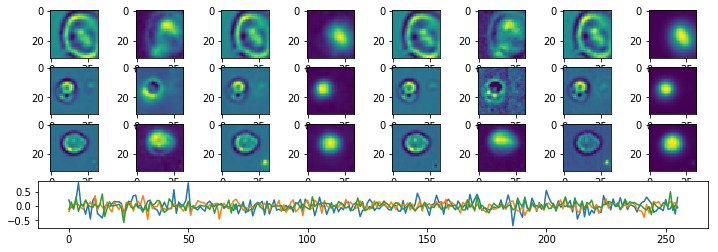

Epoch:  84 Iteration:  0 Loss:  1.2928402 0.66372156 0.0


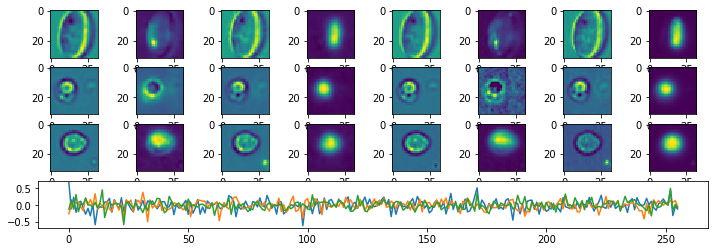

Epoch:  84 Iteration:  500 Loss:  1.317457 0.6880473 0.0


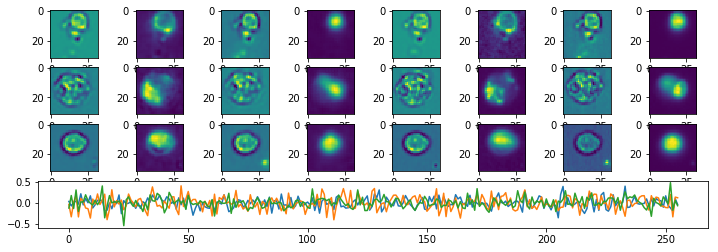

Epoch:  84 Iteration:  1000 Loss:  1.2855712 0.6561873 0.0


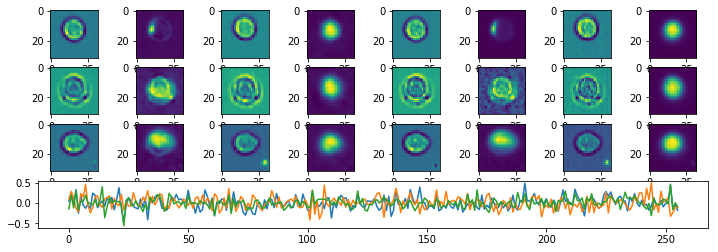

Epoch:  85 Iteration:  0 Loss:  1.2558854 0.62678695 0.0


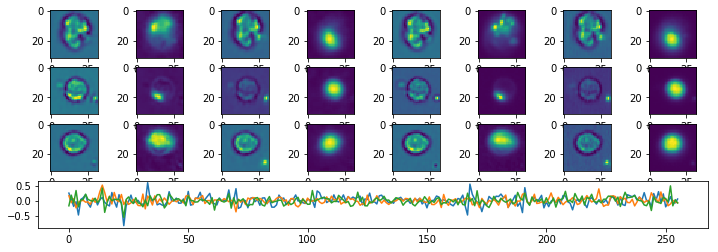

Epoch:  85 Iteration:  500 Loss:  1.300775 0.67137444 0.0


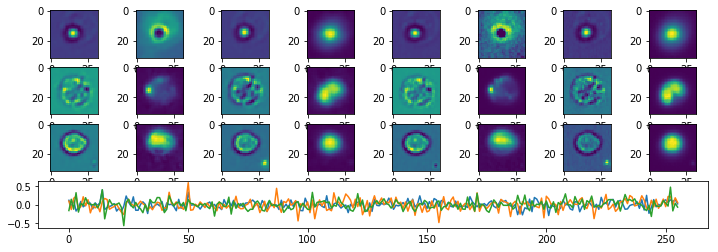

Epoch:  85 Iteration:  1000 Loss:  1.2708304 0.64145476 0.0


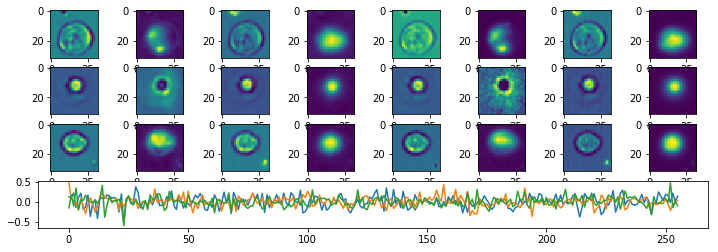

Epoch:  86 Iteration:  0 Loss:  1.2449398 0.61584723 0.0


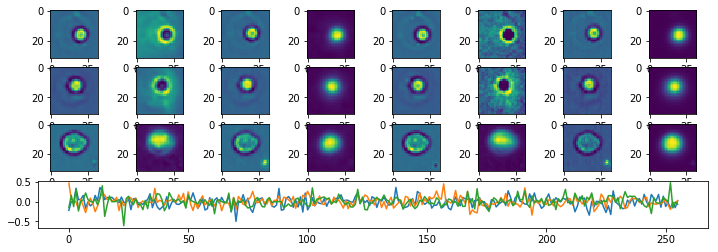

Epoch:  86 Iteration:  500 Loss:  1.2947497 0.6653524 0.0


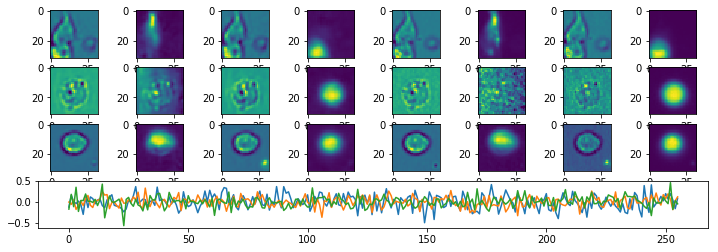

Epoch:  86 Iteration:  1000 Loss:  1.266801 0.63742757 0.0


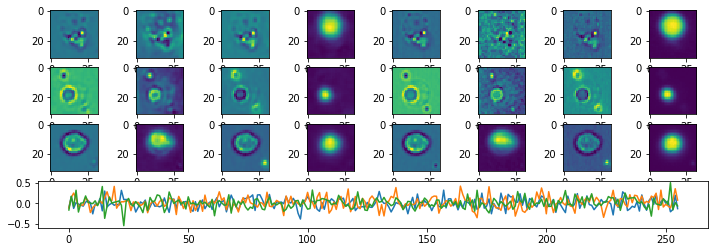

Epoch:  87 Iteration:  0 Loss:  1.2419581 0.6128676 0.0


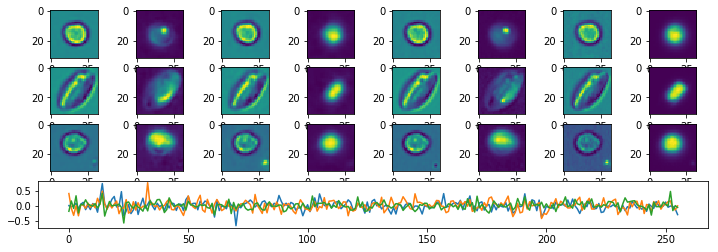

Epoch:  87 Iteration:  500 Loss:  1.2857296 0.65633714 0.0


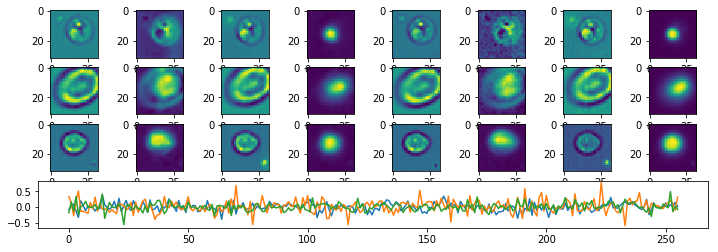

Epoch:  87 Iteration:  1000 Loss:  1.2613175 0.63194716 0.0


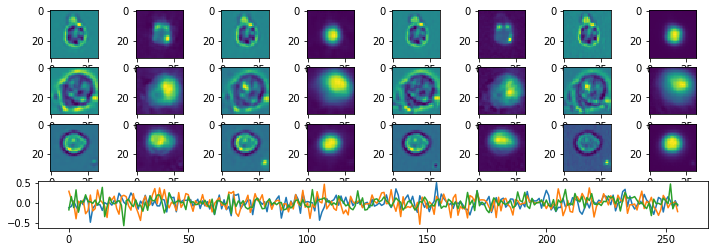

Epoch:  88 Iteration:  0 Loss:  1.2420897 0.6129989 0.0


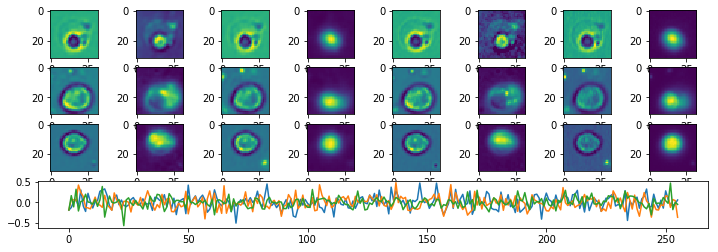

Epoch:  88 Iteration:  500 Loss:  1.2849531 0.65556103 0.0


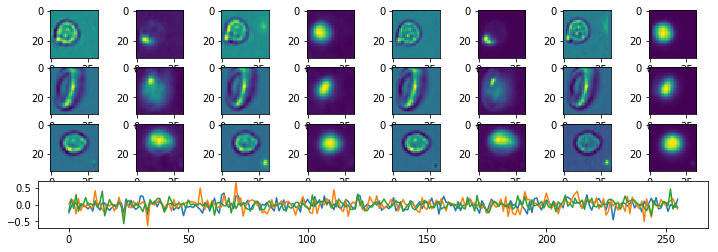

Epoch:  88 Iteration:  1000 Loss:  1.2606212 0.6312515 0.0


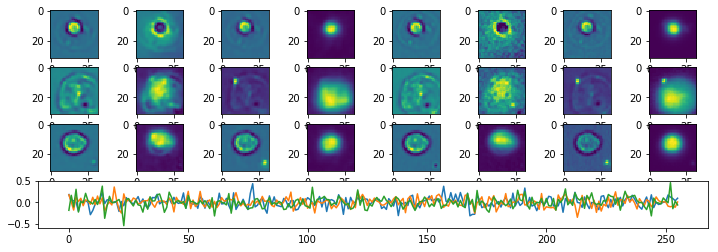

Epoch:  89 Iteration:  0 Loss:  1.2410135 0.6119238 0.0


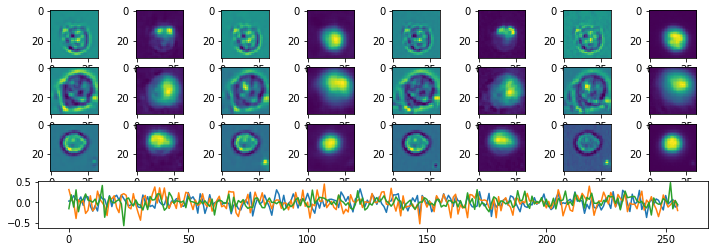

Epoch:  89 Iteration:  500 Loss:  1.2842405 0.65484893 0.0


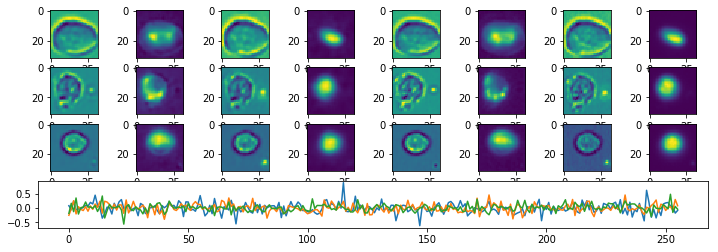

Epoch:  89 Iteration:  1000 Loss:  1.2660618 0.6366887 0.0


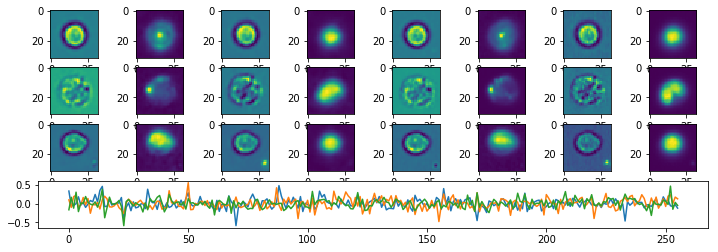

Epoch:  90 Iteration:  0 Loss:  1.2352042 0.6061173 0.0


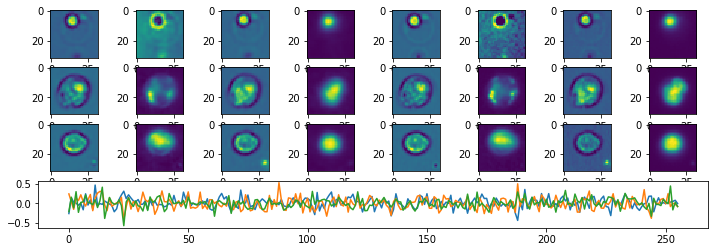

Epoch:  90 Iteration:  500 Loss:  1.2901175 0.6607226 0.0


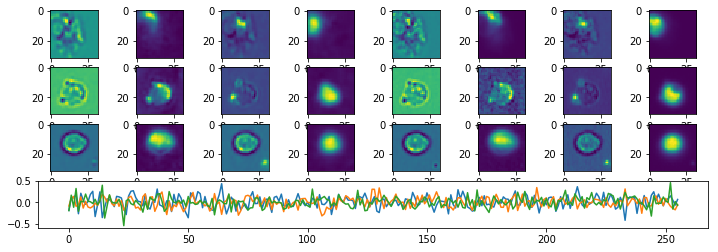

Epoch:  90 Iteration:  1000 Loss:  1.2611487 0.63177884 0.0


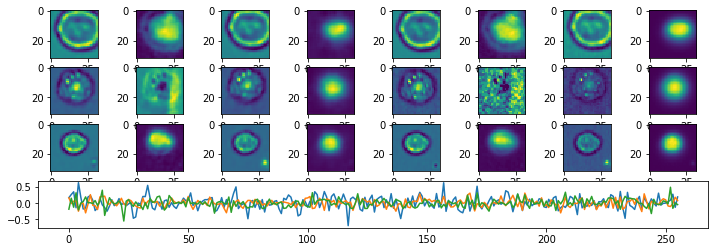

Epoch:  91 Iteration:  0 Loss:  1.2392713 0.6101823 0.0


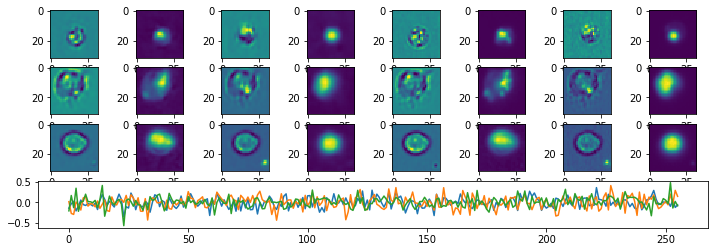

Epoch:  91 Iteration:  500 Loss:  1.2833912 0.6539997 0.0


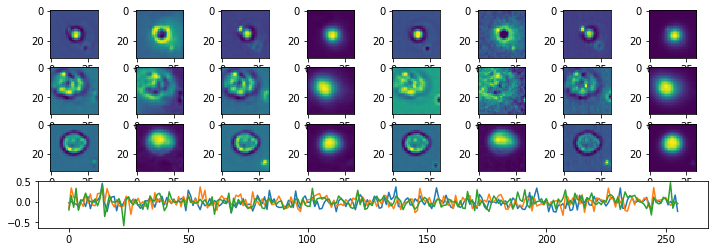

Epoch:  91 Iteration:  1000 Loss:  1.2528739 0.6235083 0.0


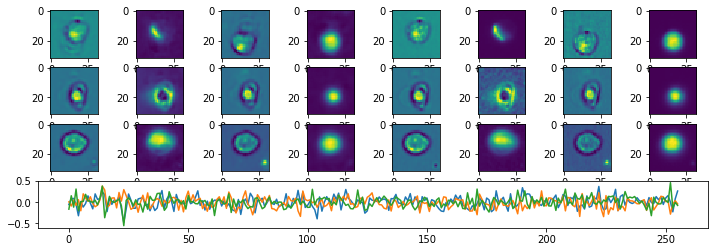

Epoch:  92 Iteration:  0 Loss:  1.2339823 0.60489607 0.0


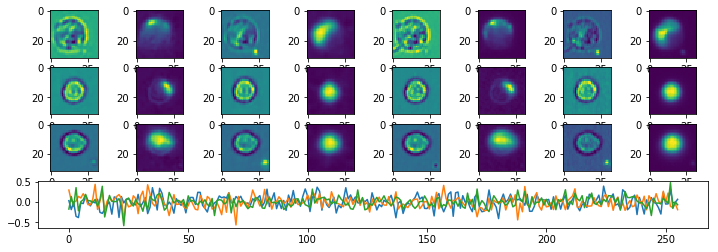

Epoch:  92 Iteration:  500 Loss:  1.2758085 0.6464213 0.0


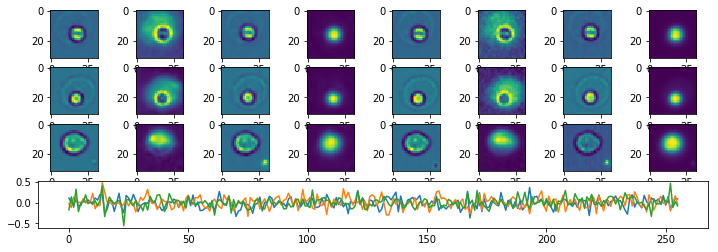

Epoch:  92 Iteration:  1000 Loss:  1.2551606 0.62579393 0.0


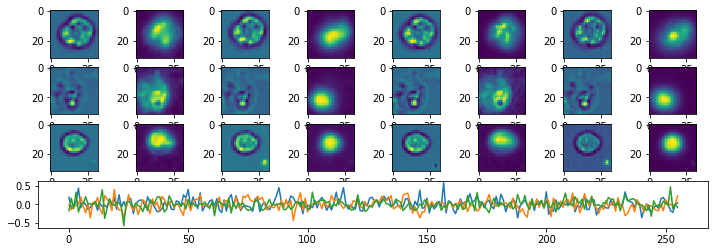

Epoch:  93 Iteration:  0 Loss:  1.2341588 0.60507256 0.0


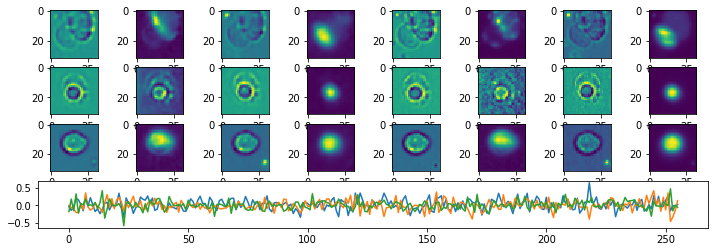

Epoch:  93 Iteration:  500 Loss:  1.2812281 0.65183806 0.0


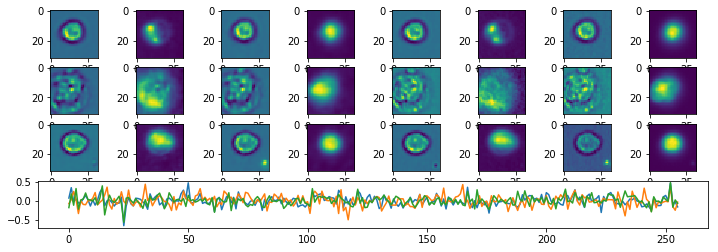

Epoch:  93 Iteration:  1000 Loss:  1.2562876 0.6269203 0.0


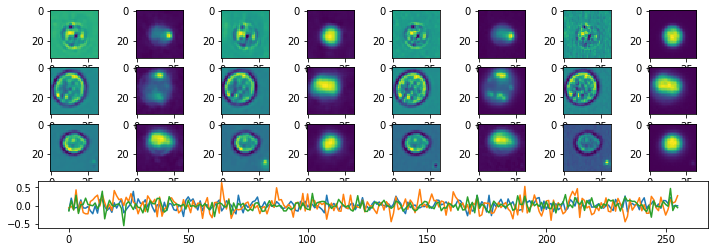

Epoch:  94 Iteration:  0 Loss:  1.2322061 0.60312057 0.0


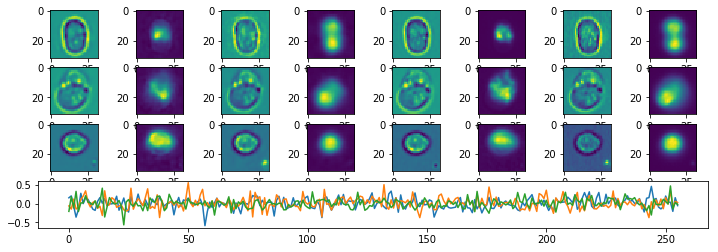

Epoch:  94 Iteration:  500 Loss:  1.2763102 0.64692295 0.0


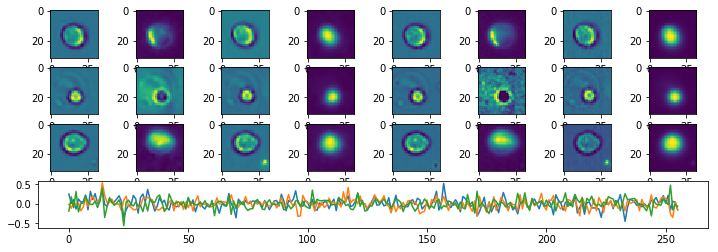

Epoch:  94 Iteration:  1000 Loss:  1.2471006 0.61773807 0.0


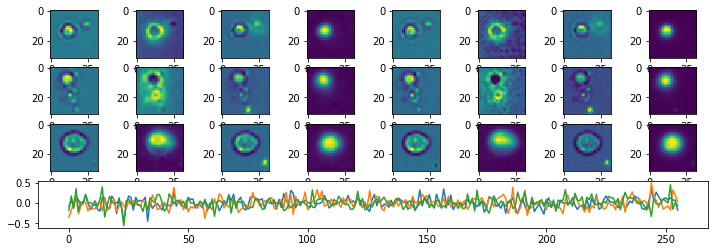

Epoch:  95 Iteration:  0 Loss:  1.2317827 0.6026976 0.0


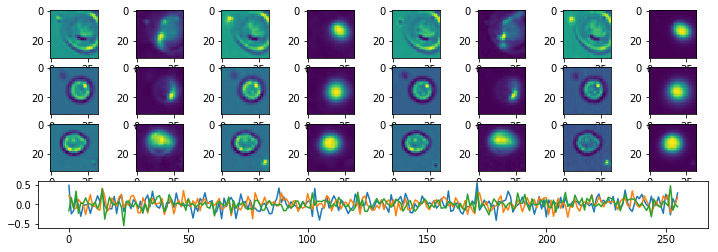

Epoch:  95 Iteration:  500 Loss:  1.2705126 0.6411278 0.0


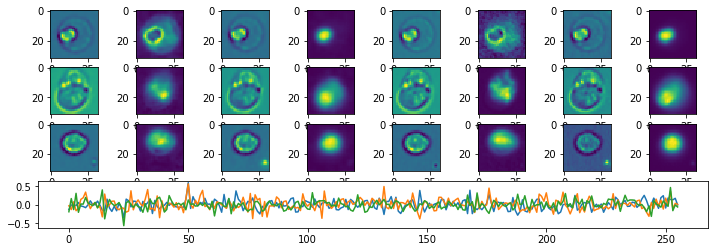

Epoch:  95 Iteration:  1000 Loss:  1.2504932 0.6211289 0.0


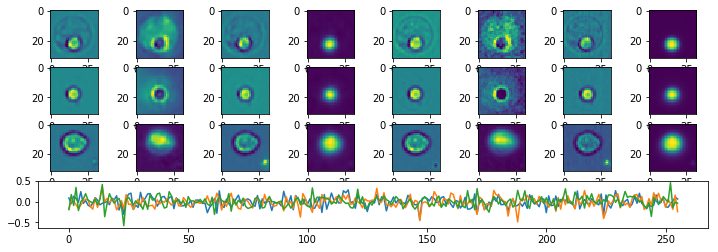

Epoch:  96 Iteration:  0 Loss:  1.2308269 0.6017421 0.0


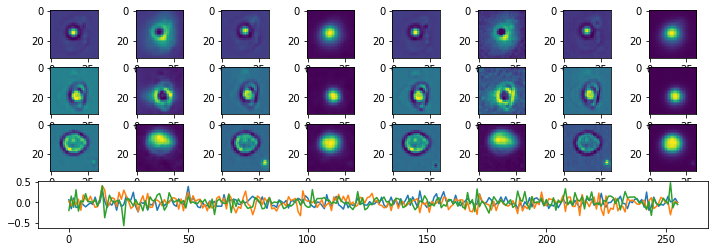

Epoch:  96 Iteration:  500 Loss:  1.2788099 0.6494211 0.0


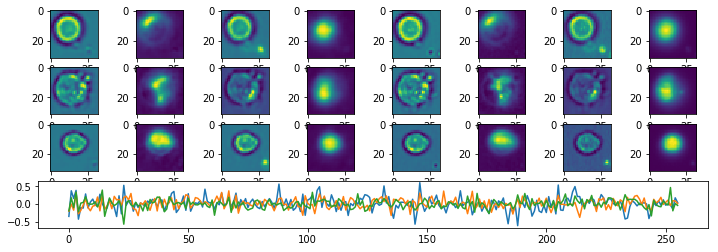

Epoch:  96 Iteration:  1000 Loss:  1.2555536 0.6261867 0.0


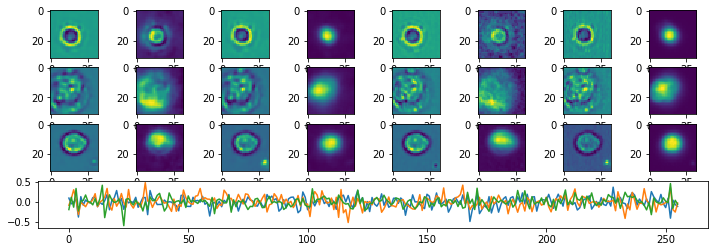

Epoch:  97 Iteration:  0 Loss:  1.2266397 0.59755737 0.0


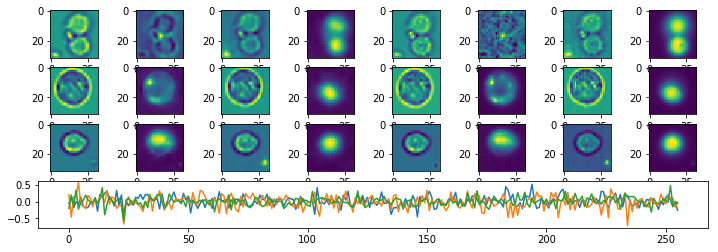

Epoch:  97 Iteration:  500 Loss:  1.2660996 0.6367175 0.0


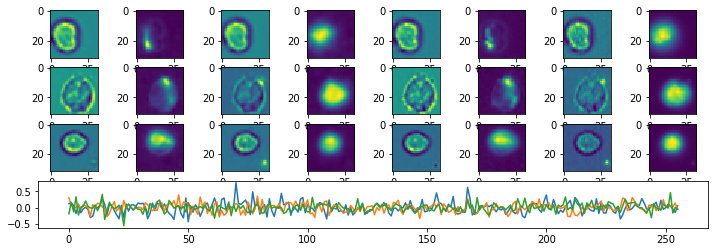

Epoch:  97 Iteration:  1000 Loss:  1.2464466 0.61708415 0.0


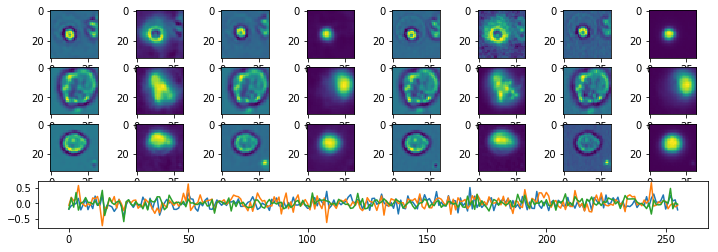

Epoch:  98 Iteration:  0 Loss:  1.2286676 0.5995842 0.0


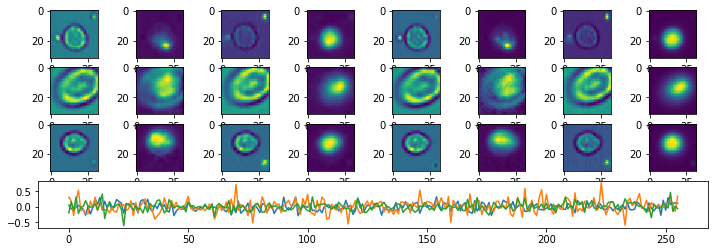

Epoch:  98 Iteration:  500 Loss:  1.2696049 0.6402203 0.0


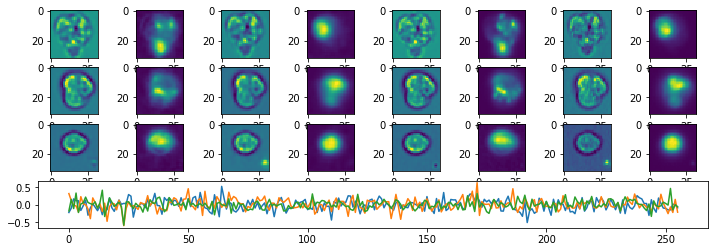

Epoch:  98 Iteration:  1000 Loss:  1.2429466 0.6135865 0.0


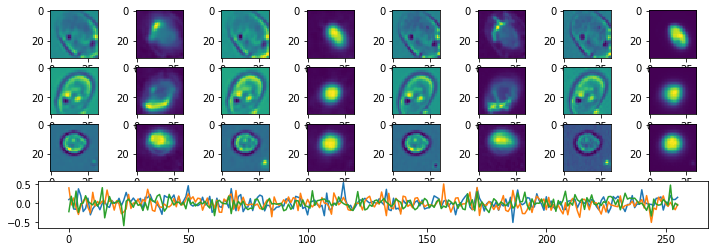

Epoch:  99 Iteration:  0 Loss:  1.2293547 0.6002705 0.0


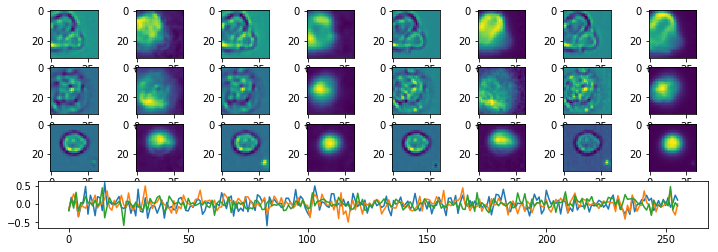

Epoch:  99 Iteration:  500 Loss:  1.2689099 0.63952607 0.0


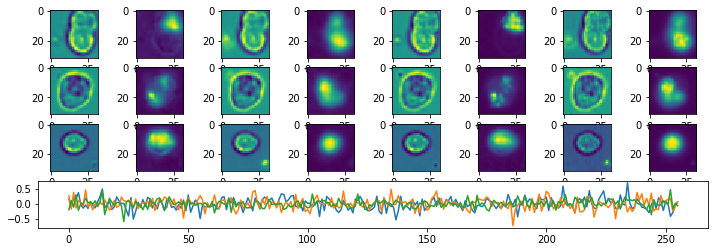

Epoch:  99 Iteration:  1000 Loss:  1.2456124 0.61625075 0.0


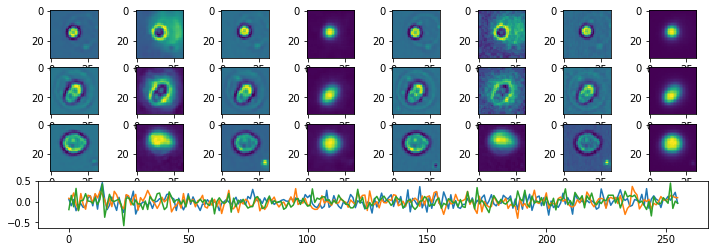

Done


In [5]:

p_mmdict = mmdict #{"Fish6_15_cjw_64.tif.mm": m3}
#             "plate04_all.mm": m4}

p_width = 32
p_height = 32
p_nchannels = 4
p_channels = [0,1,3,4]
p_nepochs = 100
p_batchsize = 128
p_learning_rate = 0.0001  #.00005
p_restore = False
p_latent_size = 256 #128 + 64
p_droprate = 0.95
p_stdev = .04

enc_sizes = [(128, 3), (256, 3), (512, 3)]  #128, 3)]
######enc_sizes = [(64, 3), (128, 3), (256,3), (512,3)] #, (64, 3), (128,3)] #, (32, 3), (64, 3)]
#enc_sizes = [(16, 5), (32, 3), (64,3), (128,3)] #, (64, 3), (128,3)] #, (32, 3), (64, 3)]
dec_sizes = list(reversed(enc_sizes))
#dec_sizes.append((p_nchannels,7))

params = dict()

params['width'] = p_width
params['height'] = p_height
params['nchannels'] = p_nchannels
params['channels'] = p_channels
params['nepochs'] = p_nepochs
params['batchsize'] = p_batchsize
params['learning_rate'] = p_learning_rate
params['restore'] = p_restore
params['latent_size'] = p_latent_size
params['droprate'] = p_droprate
params['stdev'] = p_stdev
params['denoise'] = None
params['slam'] = 0.00
params['enc_sizes'] = enc_sizes
params['dec_sizes'] = dec_sizes

#cpdir = "/media/cjw/Data/cyto/Checkpoints/2018-06-07-256"
cpdir = "/v/Data/cyto/Checkpoints/2018-06-12-256"

if not os.path.exists(cpdir):
    os.makedirs(cpdir)
autoencoder_train.train(p_mmdict, p_df, params, 500, cpdir)

In [ ]:
x = 4
x